# CPTAC ID mapping

BCM CPTAC phosphoproteomics provides ensembl ID + site, but a lot of webtools has ID like gene + site, so we have to map the ensembl ID to the gene name that match with webtool.

## Setup

In [ ]:
from katlas.core import *
# from katlas.plot import *

from tqdm import tqdm

import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

## One-hot encode

In [ ]:
from katlas.feature import *
from katlas.plot import *

In [ ]:
# Define the amino acids and positions
amino_acids = ['P', 'G', 'A', 'C', 'S', 'T', 'V', 'I', 'L', 'M', 'F', 'Y', 'W', 'H', 'K', 'R', 'Q', 'N', 'D', 'E']
positions = positions = [i for i in range(-7, 8) if i != 0 ]

# Create the columns for the new dataframe
columns = [f"{pos}{aa}" for pos in positions for aa in amino_acids]

# Initialize the new dataframe with zeros
new_df = pd.DataFrame(0, index=unique_site.index, columns=columns)

new_df['0S']=0
new_df['0T']=0
new_df['0Y']=0

# Function to update the new dataframe
def update_dataframe(row):
    sequence = row['site_seq']
    mid = len(sequence) // 2
    for index, aa in enumerate(sequence):
        pos = index - mid
        col_name = f"{pos}{aa}"
        if col_name in new_df.columns:
            new_df.at[row.name, col_name] = 1

# Apply the function to each row in the original dataframe
_=unique_site.apply(update_dataframe, axis=1)

In [ ]:
X = reduce_feature(new_df,'umap',complexity=15)

/usr/local/lib/python3.9/dist-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [ ]:
sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
sns.set_context('notebook')
sns.set_style("ticks")

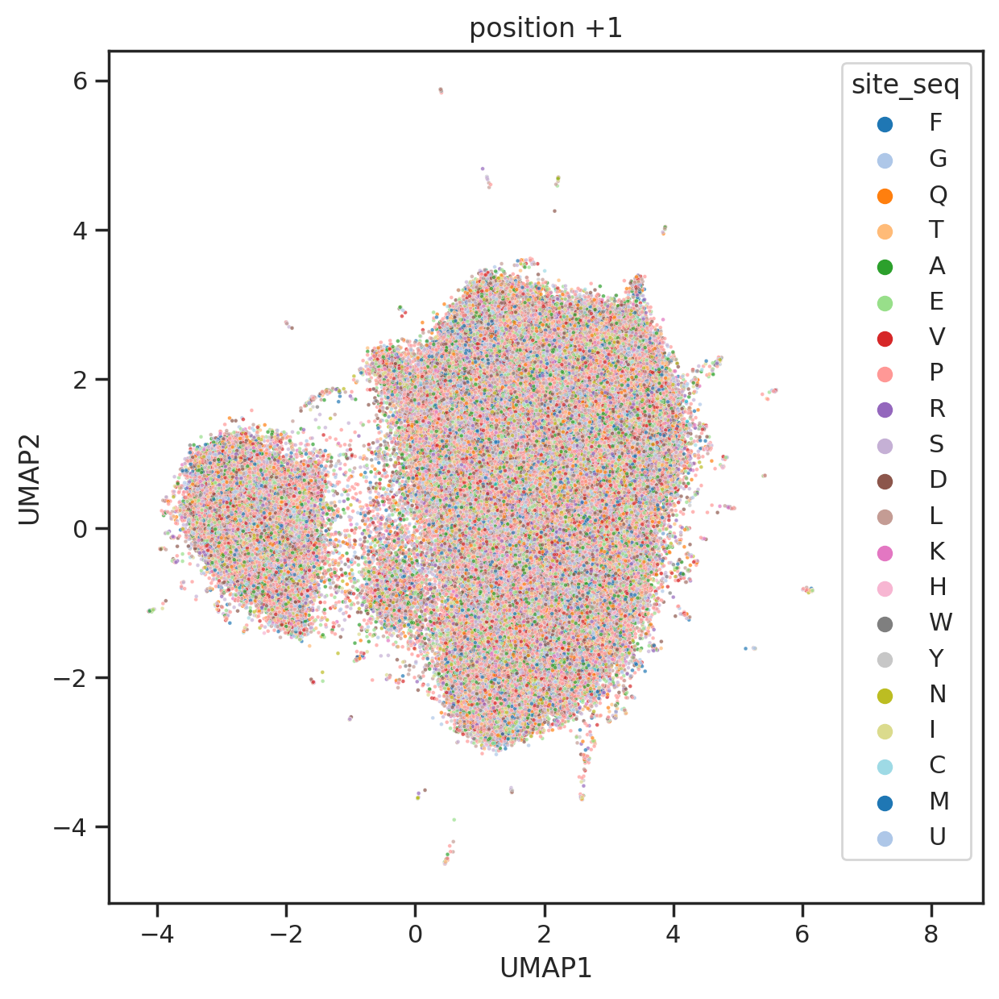

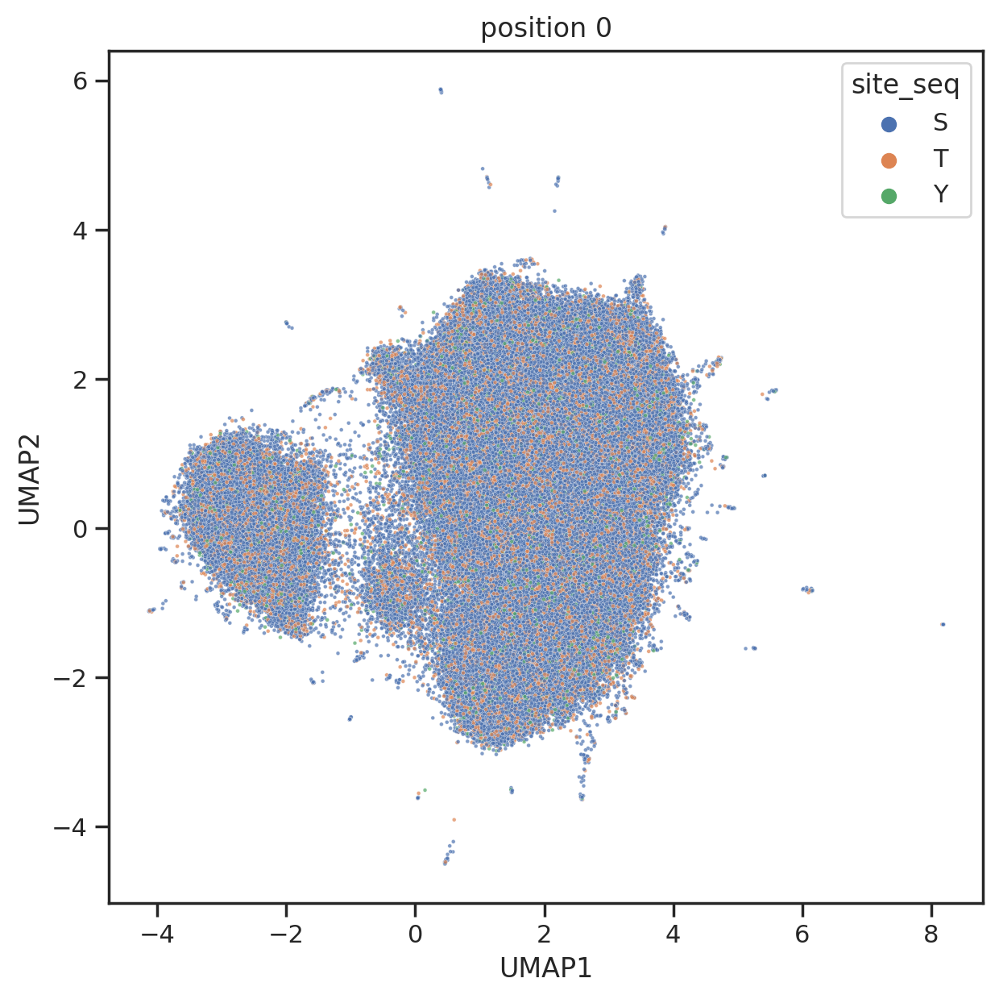

In [ ]:
plt.figure(figsize=(7,7))
sns.scatterplot(data = X,x=X.columns[0],y=X.columns[1],s=3,hue=unique_site.site_seq.str[8],alpha=0.7,palette='tab20')
plt.title('position +1')
plt.show()
plt.close()


plt.figure(figsize=(7,7))
sns.scatterplot(data = X,x=X.columns[0],y=X.columns[1],s=3,hue=unique_site.site_seq.str[7],alpha=0.7)
plt.title('position 0')
plt.show()
plt.close()

In [ ]:
idx = unique_site.site_seq.tolist()
plot_bokeh_category(X,idx,cat=unique_site.site_seq.str[8],s=1)

Loading BokehJS ...

## Site scoring

In [ ]:
df = unique_site.copy()

In [ ]:
df['site_seq']=df['site_seq'].str.replace('U','_',regex=False)

Check if other wired amino acid

In [ ]:
all_sequences = ''.join(df['site_seq'])

unique_characters = set(all_sequences)

In [ ]:
len(unique_characters)

21

Split sequence to columns

In [ ]:
split_cols = df.site_seq.apply(list).apply(pd.Series)
split_cols.columns = list(range(-7,8))
df = pd.concat([df,split_cols],axis=1)

In [ ]:
df['acceptor'] = df[0]

In [ ]:
ref = Data.get_ks_main_upper()

In [ ]:
ref

substrate,-7P,-7G,-7A,-7C,-7S,-7T,-7V,-7I,-7L,-7M,-7F,-7Y,-7W,-7H,-7K,-7R,-7Q,-7N,-7D,-7E,-6P,-6G,-6A,-6C,-6S,-6T,-6V,-6I,-6L,-6M,-6F,-6Y,-6W,-6H,-6K,-6R,-6Q,-6N,-6D,-6E,-5P,-5G,-5A,-5C,-5S,-5T,-5V,-5I,-5L,-5M,-5F,-5Y,-5W,-5H,-5K,-5R,-5Q,-5N,-5D,-5E,-4P,-4G,-4A,-4C,-4S,-4T,-4V,-4I,-4L,-4M,-4F,-4Y,-4W,-4H,-4K,-4R,-4Q,-4N,-4D,-4E,-3P,-3G,-3A,-3C,-3S,-3T,-3V,-3I,-3L,-3M,-3F,-3Y,-3W,-3H,-3K,-3R,-3Q,-3N,-3D,-3E,-2P,-2G,-2A,-2C,-2S,-2T,-2V,-2I,-2L,-2M,-2F,-2Y,-2W,-2H,-2K,-2R,-2Q,-2N,-2D,-2E,-1P,-1G,-1A,-1C,-1S,-1T,-1V,-1I,-1L,-1M,-1F,-1Y,-1W,-1H,-1K,-1R,-1Q,-1N,-1D,-1E,1P,1G,1A,1C,1S,1T,1V,1I,1L,1M,1F,1Y,1W,1H,1K,1R,1Q,1N,1D,1E,2P,2G,2A,2C,2S,2T,2V,2I,2L,2M,2F,2Y,2W,2H,2K,2R,2Q,2N,2D,2E,3P,3G,3A,3C,3S,3T,3V,3I,3L,3M,3F,3Y,3W,3H,3K,3R,3Q,3N,3D,3E,4P,4G,4A,4C,4S,4T,4V,4I,4L,4M,4F,4Y,4W,4H,4K,4R,4Q,4N,4D,4E,5P,5G,5A,5C,5S,5T,5V,5I,5L,5M,5F,5Y,5W,5H,5K,5R,5Q,5N,5D,5E,6P,6G,6A,6C,6S,6T,6V,6I,6L,6M,6F,6Y,6W,6H,6K,6R,6Q,6N,6D,6E,7P,7G,7A,7C,7S,7T,7V,7I,7L,7M,7F,7Y,7W,7H,7K,7R,7Q,7N,7D,7E,0S,0T,0Y
kinase,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SRC,0.050985,0.068752,0.056392,0.009270,0.071070,0.045964,0.047122,0.035535,0.084589,0.024334,0.029741,0.030900,0.009270,0.017767,0.093086,0.078795,0.043260,0.040942,0.075319,0.086906,0.061366,0.069085,0.061752,0.010035,0.067541,0.049016,0.049016,0.045156,0.065612,0.017754,0.034736,0.029332,0.008491,0.021227,0.085681,0.060208,0.048630,0.038981,0.078734,0.097646,0.048499,0.065050,0.066205,0.013472,0.062356,0.048114,0.044650,0.050038,0.071594,0.016551,0.032717,0.035797,0.008853,0.021555,0.075828,0.046959,0.046574,0.042725,0.089684,0.112779,0.054573,0.078786,0.058417,0.015757,0.089547,0.044581,0.049577,0.037663,0.079170,0.015373,0.029593,0.036895,0.005380,0.019985,0.051499,0.053805,0.041507,0.043044,0.089547,0.105304,0.049155,0.068356,0.074501,0.008065,0.072197,0.046851,0.052227,0.032258,0.053379,0.012673,0.022273,0.043395,0.008065,0.020353,0.058756,0.042627,0.058756,0.041475,0.093318,0.141321,0.065643,0.080998,0.059885,0.010749,0.078695,0.050672,0.053743,0.035701,0.051056,0.010749,0.027639,0.039923,0.007294,0.023800,0.062188,0.033397,0.049520,0.054511,0.097121,0.106718,0.057582,0.047601,0.064107,0.015739,0.054127,0.060269,0.101727,0.083301,0.094818,0.008445,0.038004,0.049904,0.007678,0.028023,0.034549,0.021881,0.036468,0.039539,0.065259,0.090979,0.020015,0.099692,0.066205,0.013857,0.074673,0.044650,0.066590,0.051193,0.061971,0.014242,0.033872,0.045035,0.006543,0.019630,0.053118,0.031178,0.053503,0.039646,0.088530,0.115858,0.049536,0.066563,0.071981,0.016641,0.078947,0.049536,0.071207,0.040635,0.075851,0.017802,0.031734,0.047988,0.010836,0.018963,0.039861,0.043344,0.045279,0.045666,0.070433,0.107198,0.068765,0.057887,0.065268,0.015540,0.066434,0.042347,0.066434,0.050894,0.118104,0.017094,0.045066,0.047786,0.008159,0.026418,0.047786,0.054390,0.029915,0.039239,0.063714,0.068765,0.056075,0.075156,0.065031,0.012072,0.062695,0.041277,0.063863,0.039330,0.070483,0.019860,0.032710,0.040109,0.008956,0.022975,0.080607,0.070093,0.038551,0.033879,0.068925,0.097352,0.055490,0.081673,0.064869,0.007816,0.070340,0.053927,0.050410,0.032825,0.081282,0.014459,0.028918,0.036733,0.006252,0.019539,0.084408,0.069558,0.046893,0.033998,0.069949,0.090660,0.060904,0.070334,0.078193,0.012967,0.067583,0.039686,0.058939,0.042043,0.078193,0.016110,0.029862,0.033399,0.005501,0.023576,0.084479,0.067976,0.044401,0.032220,0.075049,0.078585,0.063216,0.066772,0.058475,0.011853,0.076254,0.044646,0.057685,0.042276,0.079415,0.024891,0.030028,0.024101,0.009878,0.026077,0.080205,0.066772,0.048597,0.034769,0.071908,0.082181,0.039539,0.049904,0.910557
EPHA3,0.038005,0.075059,0.064133,0.014727,0.071259,0.039905,0.045131,0.056057,0.081710,0.022328,0.024703,0.028029,0.017577,0.023753,0.094062,0.090736,0.034204,0

In [ ]:
results = predict_kinase(df,ref,seq_col='site_seq',seq_id='gene_site2')

100%|██████████| 289/289 [02:36<00:00,  1.84it/s]


In [ ]:
results = results.T

In [ ]:
results = pd.read_parquet('results.parquet')

If normalize

In [ ]:
# from sklearn.preprocessing import StandardScaler

# r = StandardScaler().fit_transform(results)

## UMAP

In [ ]:
results_umap = reduce_feature(results,'umap',complexity=15)

/usr/local/lib/python3.9/dist-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [ ]:
results_umap = pd.read_parquet('results_umap.parquet')

In [ ]:
results_umap2 = reduce_feature(r,'umap',complexity=15)

/usr/local/lib/python3.9/dist-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [ ]:
aa = [i for i in 'PGACSTVILMFYWHKRQNDE_']

In [ ]:
aa_palette= assign_color(aa)

In [ ]:
sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
sns.set_context('notebook')
sns.set_style("ticks")

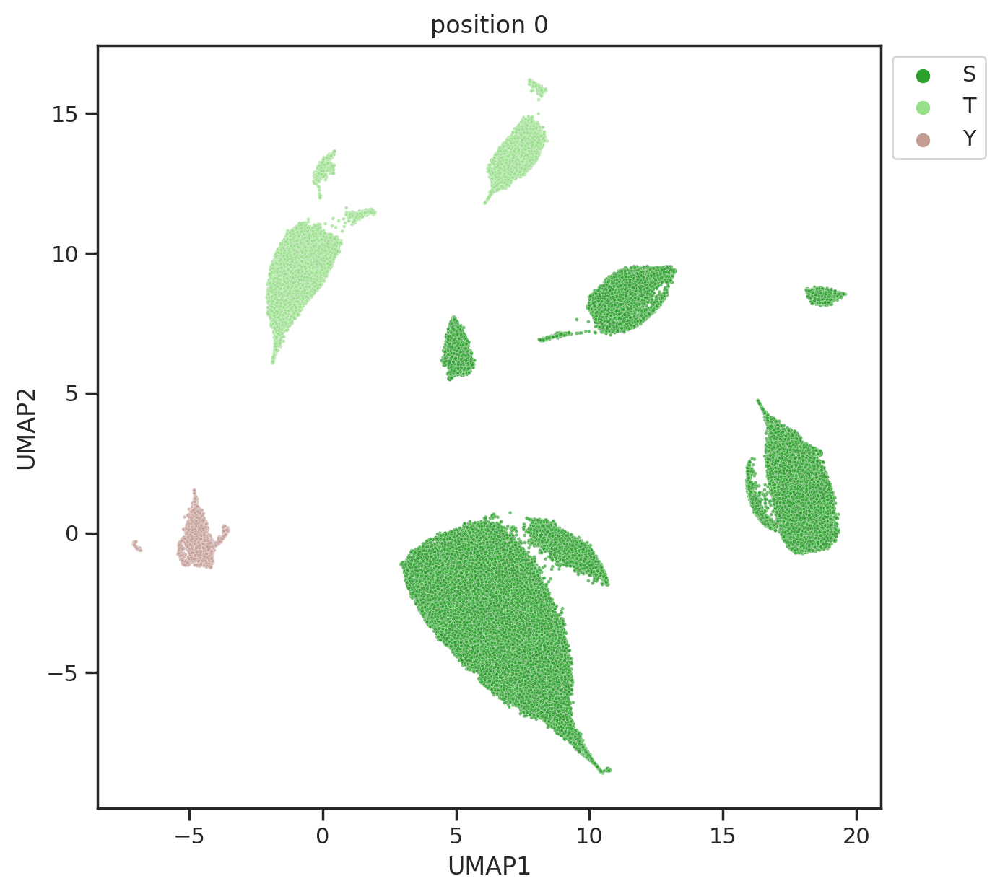

In [ ]:
plot_2d(results_umap,hue=unique_site.site_seq.str[7],palette=aa_palette)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.title('position 0');

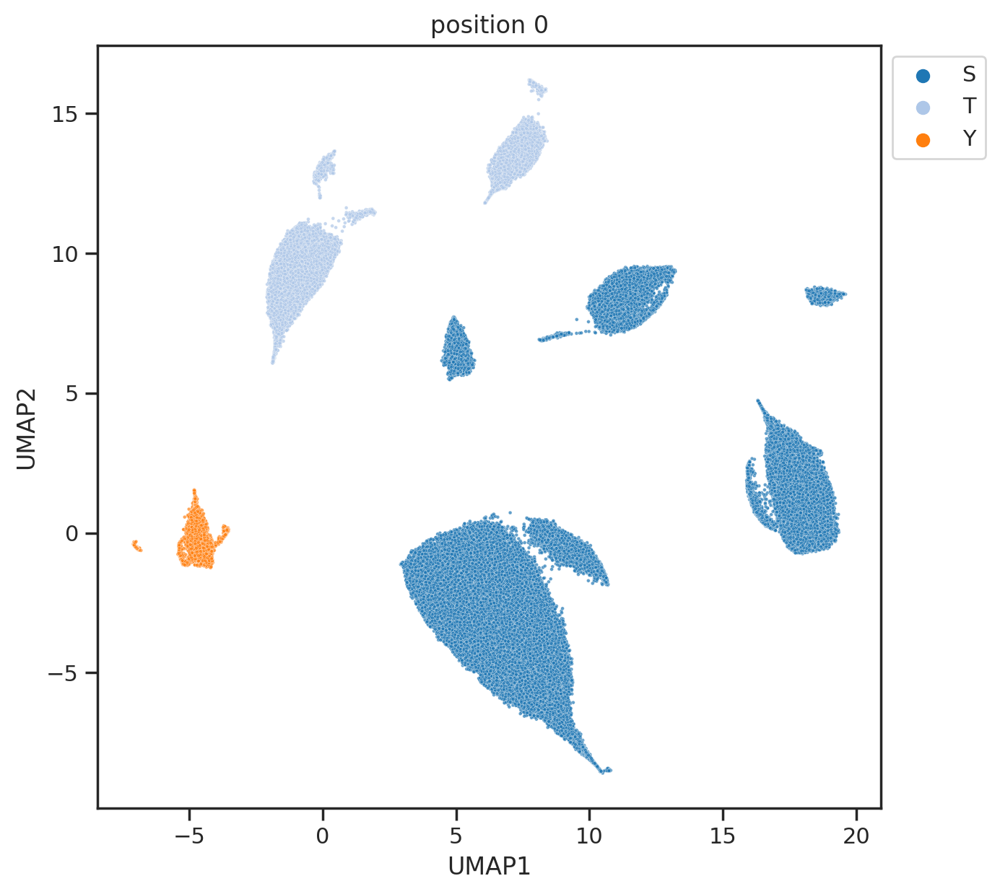

In [ ]:
plot_2d(results_umap,hue=unique_site.site_seq.str[7],palette='tab20')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.title('position 0');

In [ ]:
unique_site['acceptor'] = unique_site.site_seq.str[7]

In [ ]:
# # Use K-means for clustering
# kmeans = KMeans(n_clusters=30)
# kmeans.fit(embedding)
# cluster_centers = kmeans.cluster_centers_
# labels = kmeans.labels_

#### Plot umap for each position

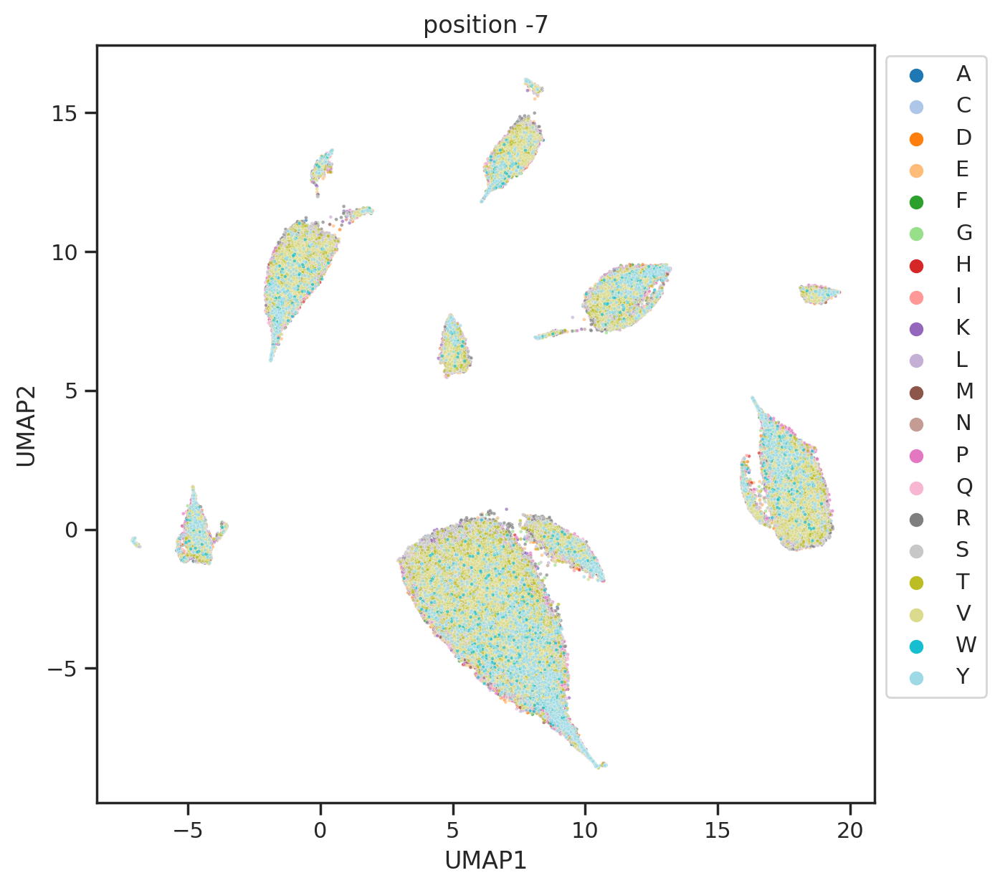

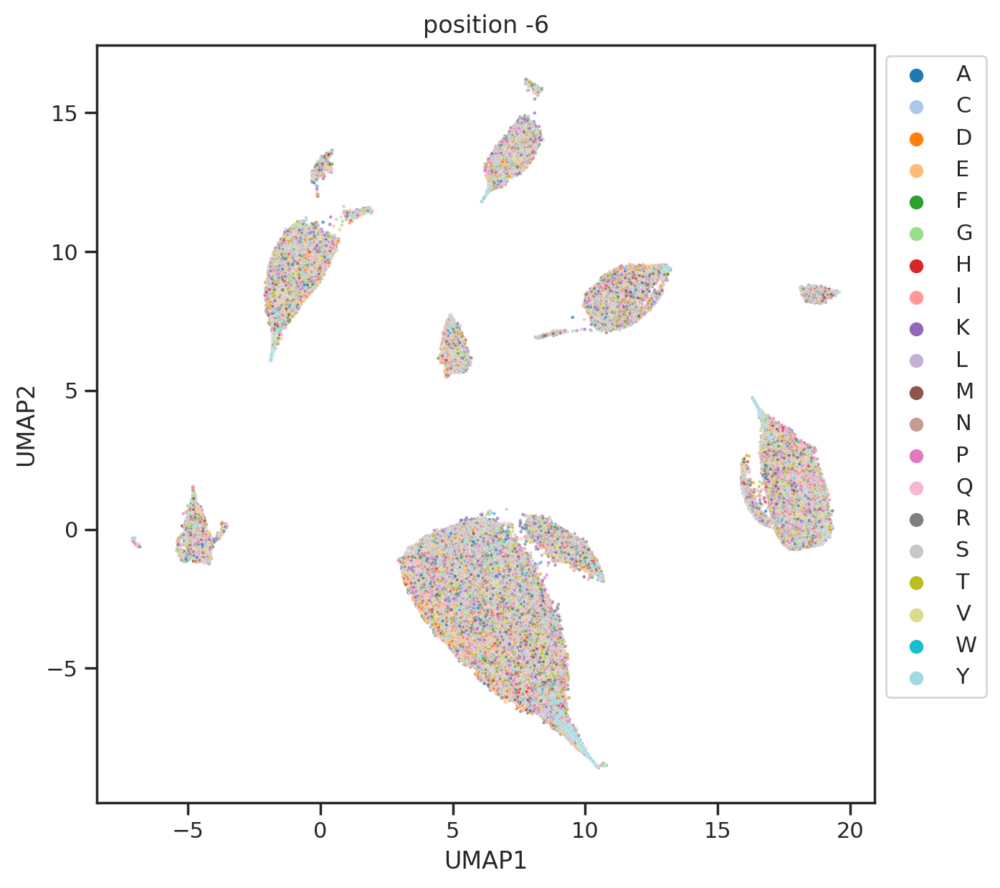

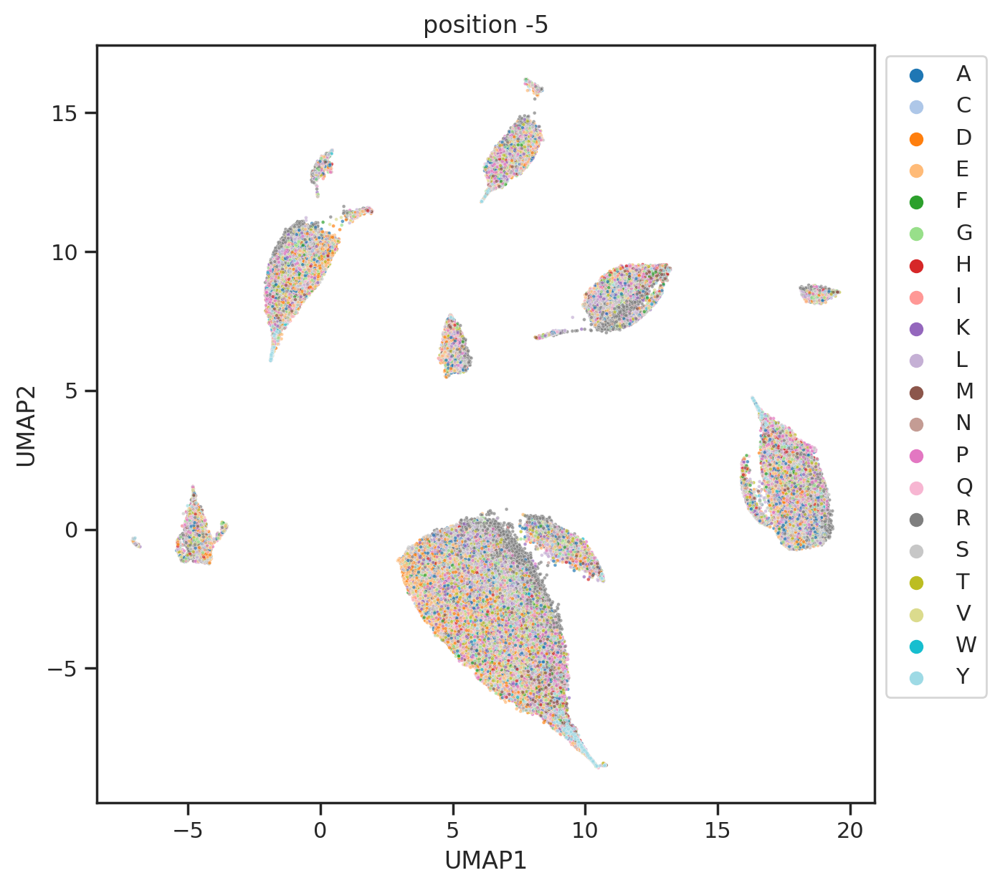

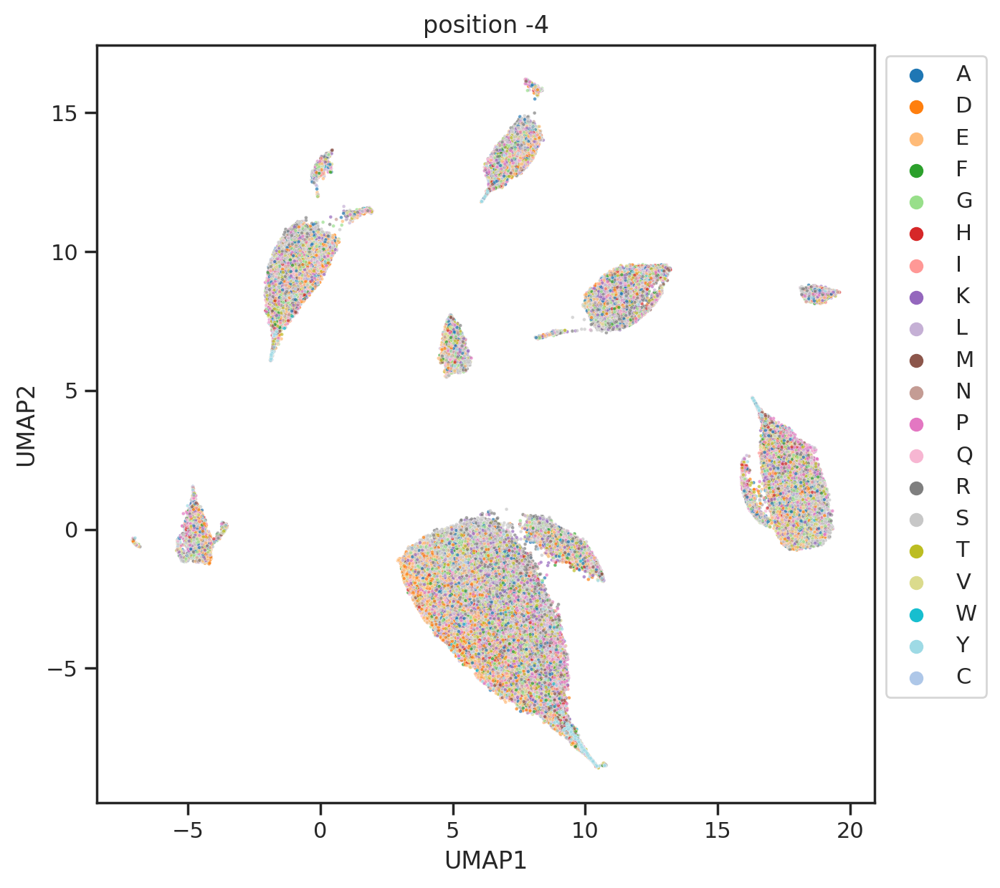

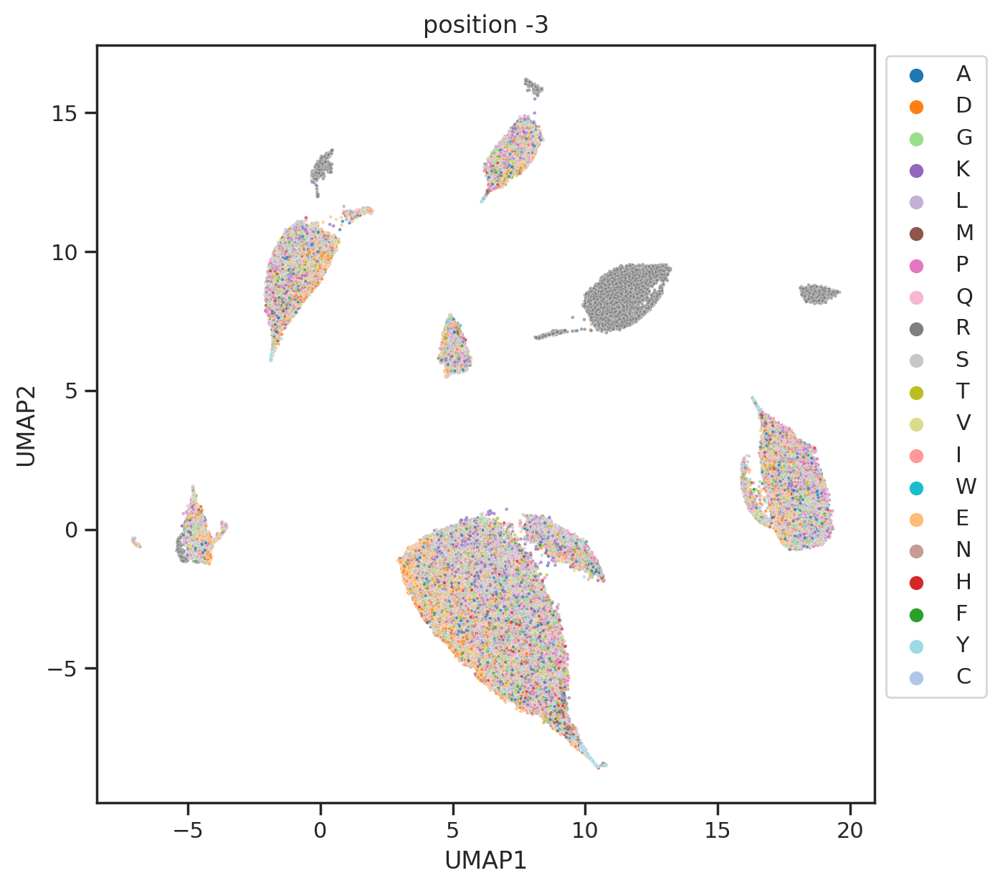

...

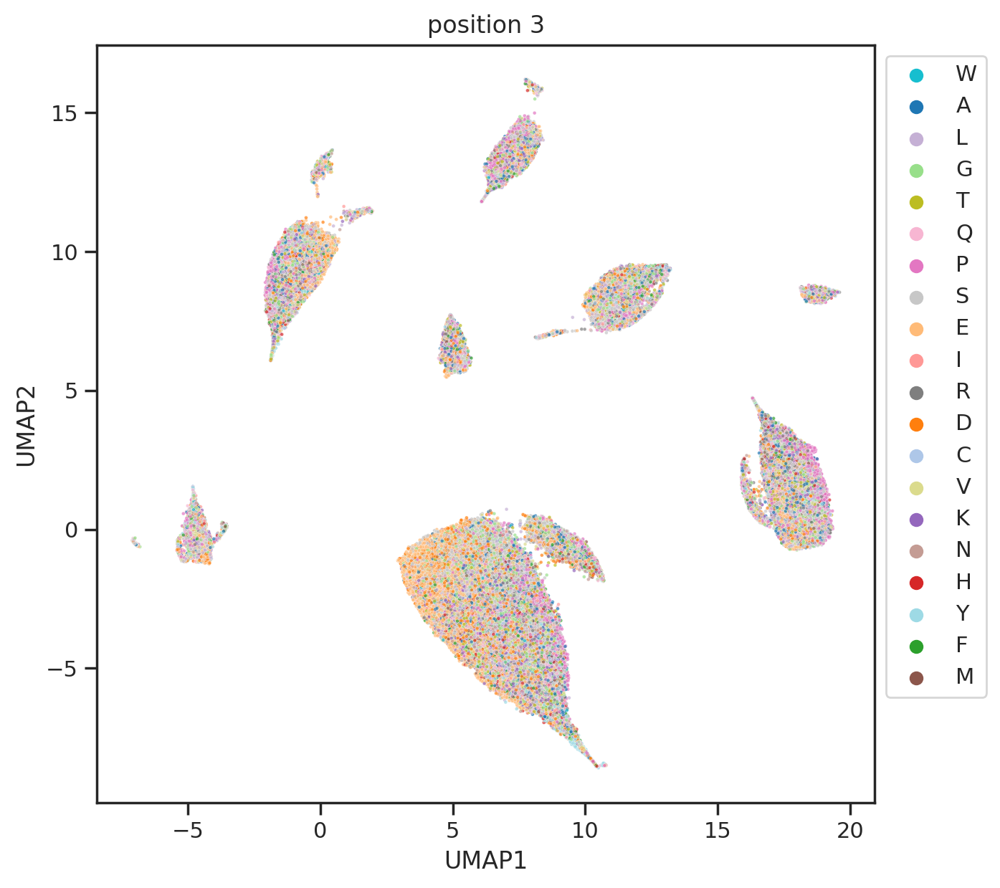

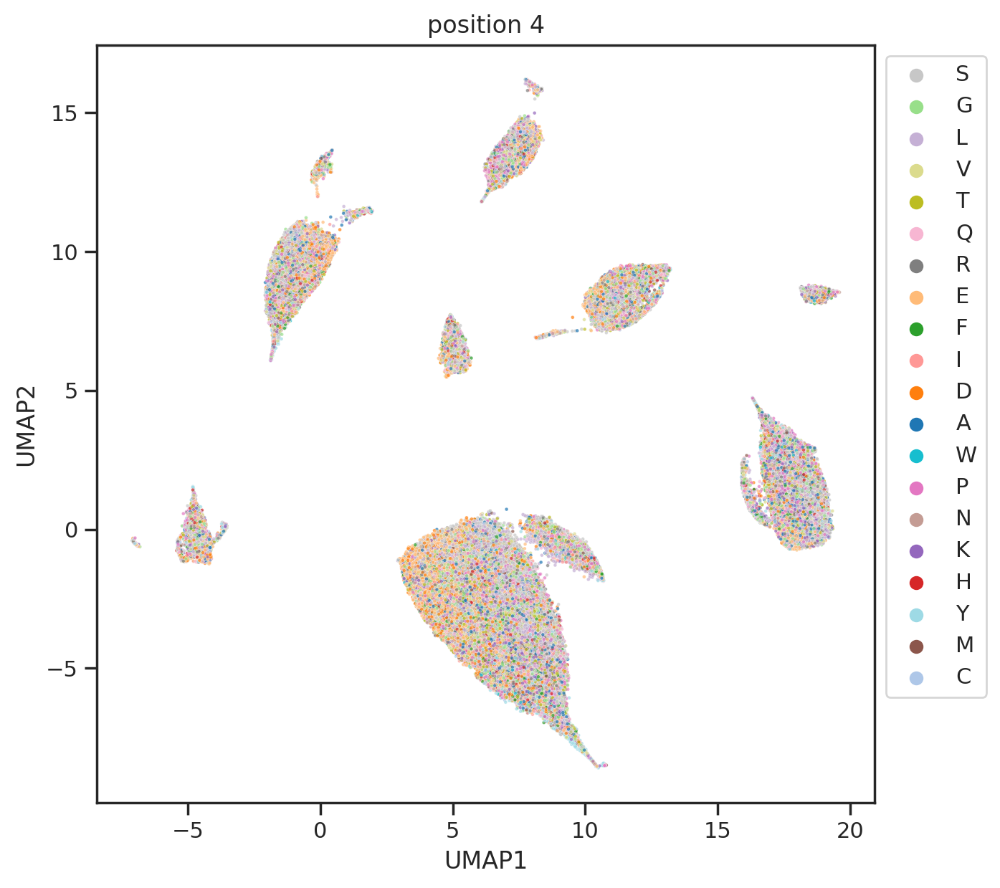

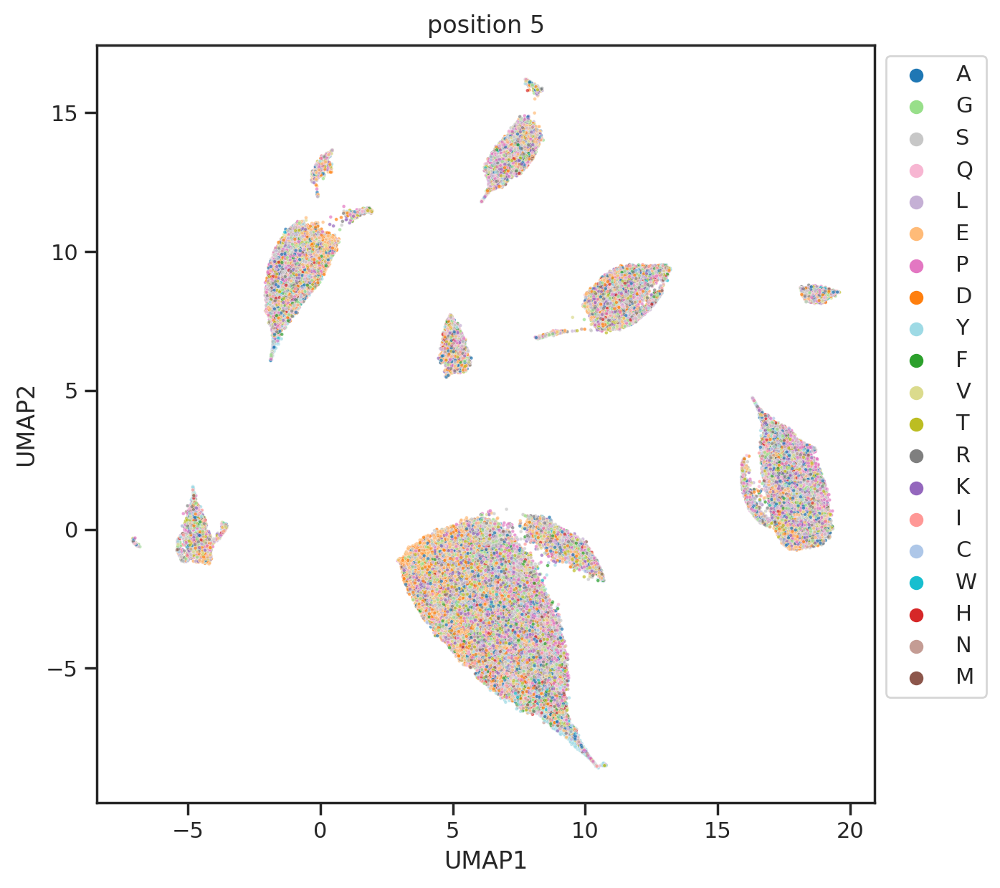

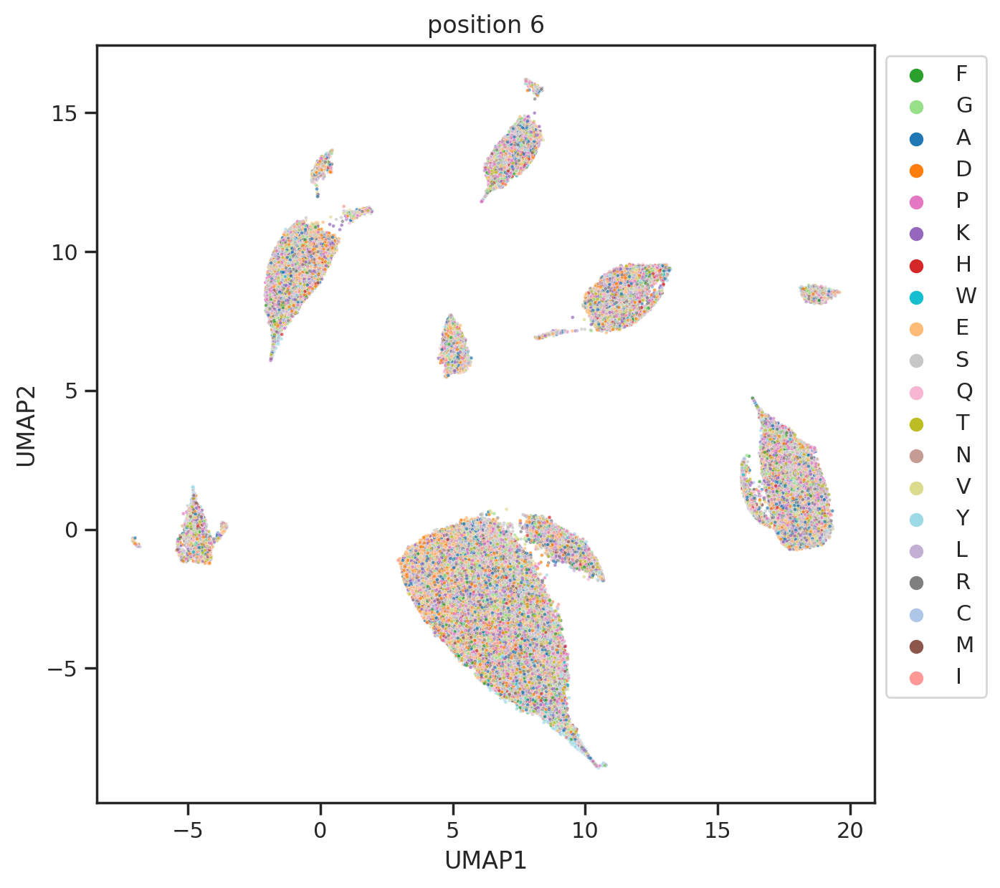

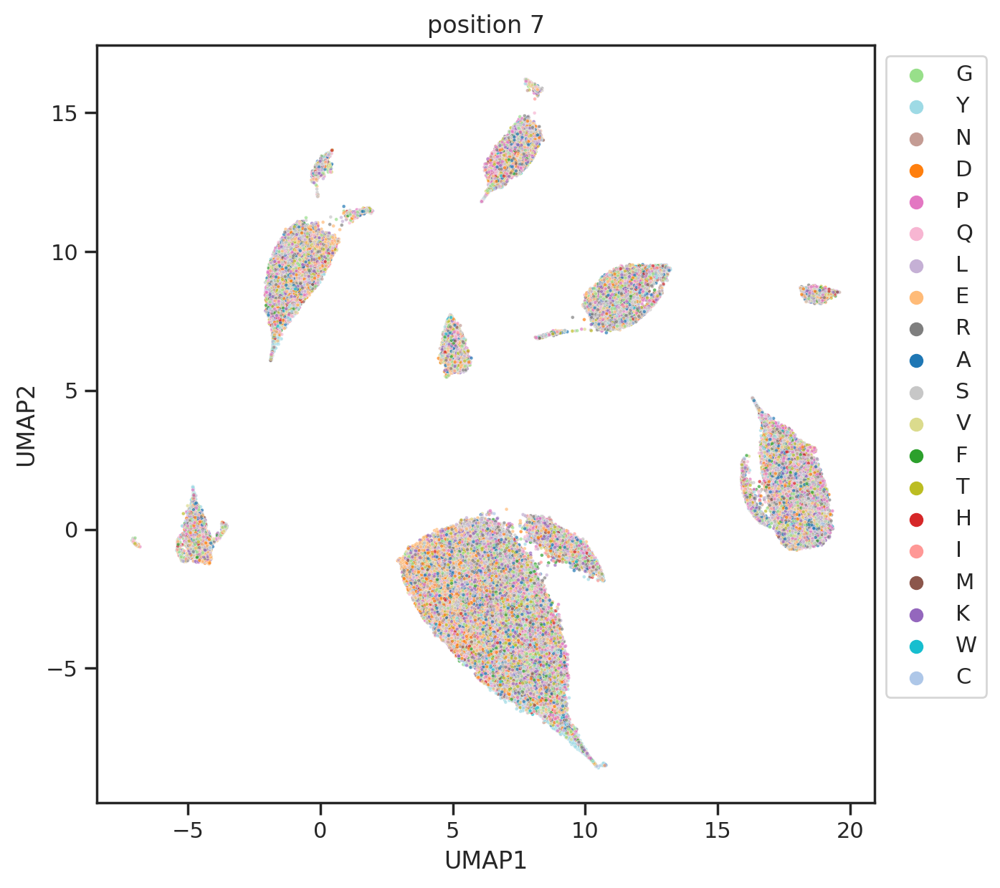

In [ ]:
for i in range(0,15):
    plot_2d(results_umap,hue=df.site_seq.str[i],palette=aa_palette)
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.title(f'position {i-7}')
    plt.show()
    plt.close()

## Annotate each cluster

In [ ]:
def assign_neg2(value):
    if value[-2] == 'R':
        return '-2R'
    elif value[-2] == 'D'or value[-2] == 'E':
        return '-2D/E'
    else:
        return ''

In [ ]:
def assign_1(value):
    if value[1] == 'P':
        return '+1P'
    elif value[1] == 'Q':
        return '+1Q'
    elif value[1] == 'D'or value[1] == 'E':
        return '+1D/E'
    
    else:
        return ''

In [ ]:
def assign_3(value):
    if value[3] == 'P':
        return '+3P'
    
    else:
        return ''

In [ ]:
df['c-3'] = df.apply(lambda x: '-3R' if x[-3]=='R' else '', axis=1)

df['c-2'] = df.apply(assign_neg2,axis=1)

df['c+1'] = df.apply(assign_1,axis=1)

df['c+3'] = df.apply(assign_3,axis=1)

In [ ]:
def custom_concat(row):
    # List to hold the non-empty values
    values = []

    # Iterate through the desired columns and add non-empty values to the list
    for col in ['c-3', 'c-2', 'c+1','c+3']:
        if row[col] != '':
            values.append(row[col])

    # Join the non-empty values with the separator
    return '|'.join(values)

In [ ]:
df['cluster'] = df.apply(custom_concat, axis=1)

In [ ]:
df['cluster'] = df['cluster'].replace('','others')

In [ ]:
df.cluster.value_counts()

others                 45979
+1P                    20457
+1D/E                  10955
-2D/E                   7213
-3R                     7182
-2R                     5234
+3P                     3897
+1Q                     3505
+1P|+3P                 2973
-2D/E|+1D/E             2692
-2D/E|+1P               2250
-3R|+1P                 1807
-3R|-2R                 1417
-2R|+1P                 1415
-3R|+1D/E               1291
-2R|+1D/E                765
-3R|-2D/E                624
-3R|+3P                  614
+1D/E|+3P                598
-2D/E|+1Q                564
-2D/E|+3P                546
-3R|+1Q                  451
-2R|+3P                  391
-3R|+1P|+3P              368
-2R|+1Q                  311
+1Q|+3P                  305
-2D/E|+1P|+3P            288
-2R|+1P|+3P              259
-3R|-2R|+1D/E            254
-3R|-2D/E|+1P            224
-3R|-2D/E|+1D/E          147
-3R|-2R|+3P              138
-3R|-2R|+1P              130
-2D/E|+1D/E|+3P          124
-3R|-2R|+1Q   

In [ ]:
cnt = df.cluster.value_counts()

n = (cnt[cnt>1000]).index

In [ ]:
df['cluster2'] = df.cluster[df.cluster.isin(n)]

In [ ]:
df['cluster3'] = df['cluster2'].fillna('subsets')

In [ ]:
df.cluster3.value_counts()

others         45979
+1P            20457
+1D/E          10955
subsets         7591
-2D/E           7213
-3R             7182
-2R             5234
+3P             3897
+1Q             3505
+1P|+3P         2973
-2D/E|+1D/E     2692
-2D/E|+1P       2250
-3R|+1P         1807
-3R|-2R         1417
-2R|+1P         1415
-3R|+1D/E       1291
Name: cluster3, dtype: int64

In [ ]:
n = df.cluster3.value_counts().index.tolist()

In [ ]:
cluster_palette = assign_color(n)

In [ ]:
sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
sns.set_context('notebook')
sns.set_style("ticks")

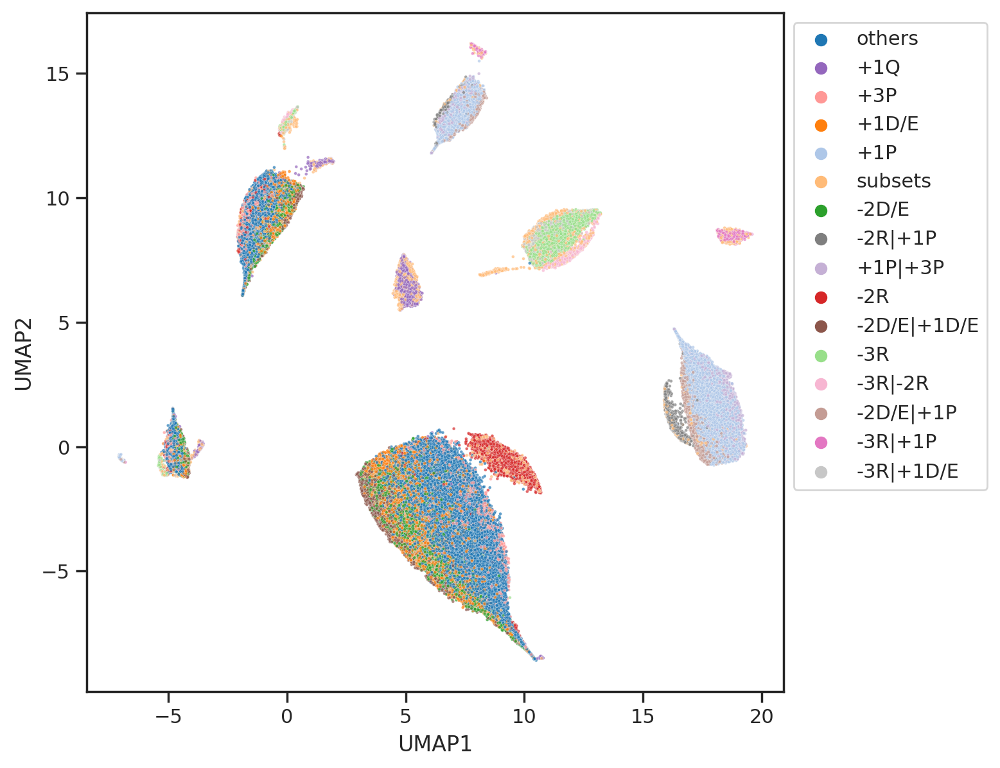

In [ ]:
plot_2d(results_umap,hue=df['cluster3'],palette=cluster_palette)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1));

<matplotlib.legend.Legend>

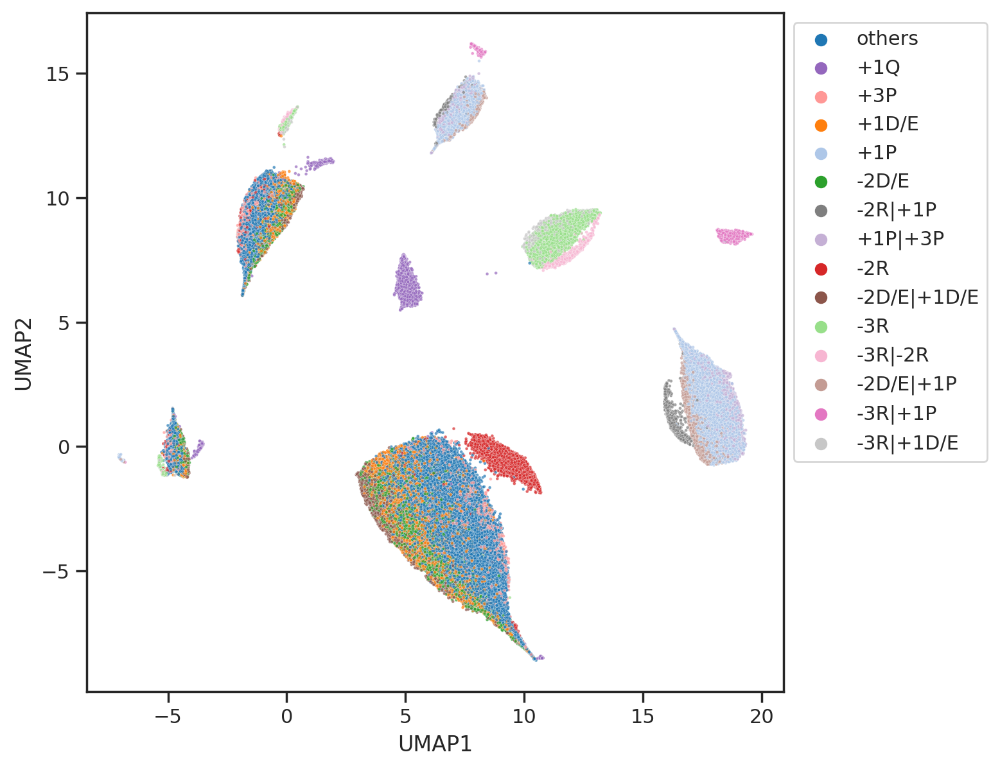

In [ ]:
plot_2d(results_umap,hue=df['cluster2'],palette=cluster_palette)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

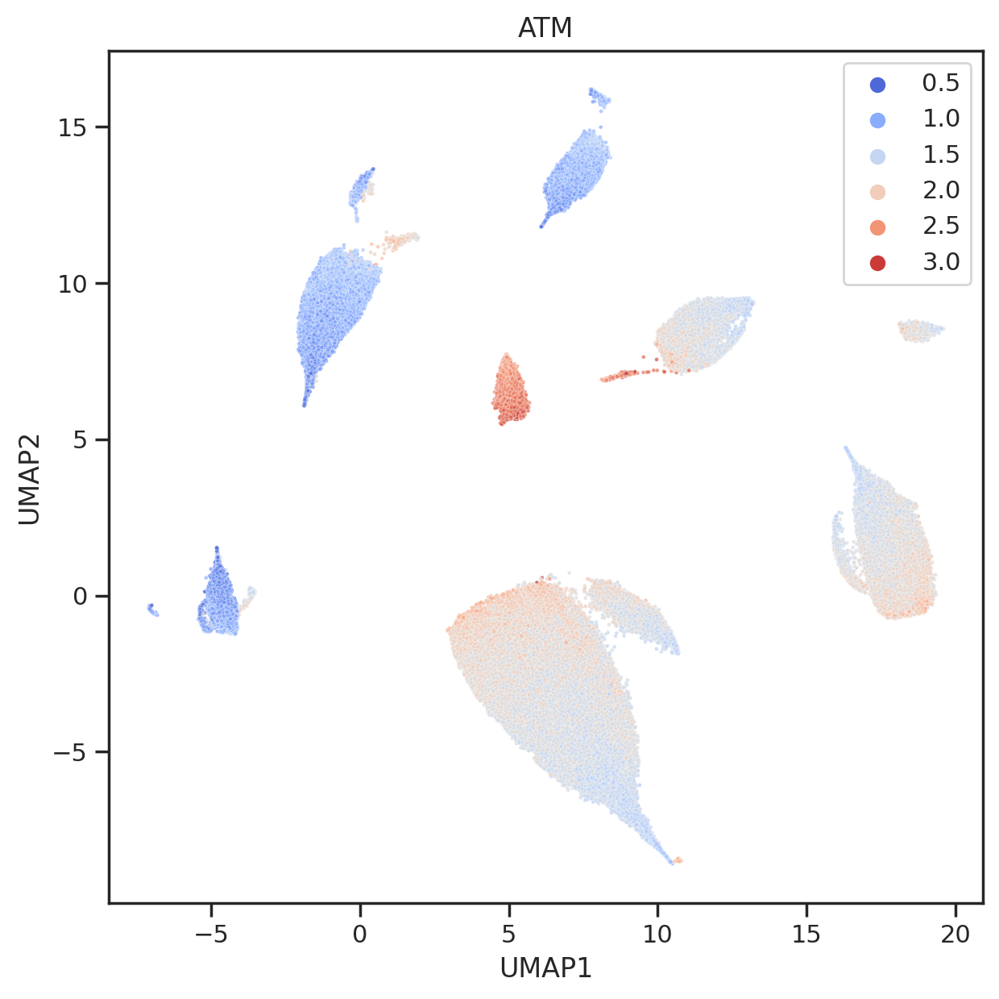

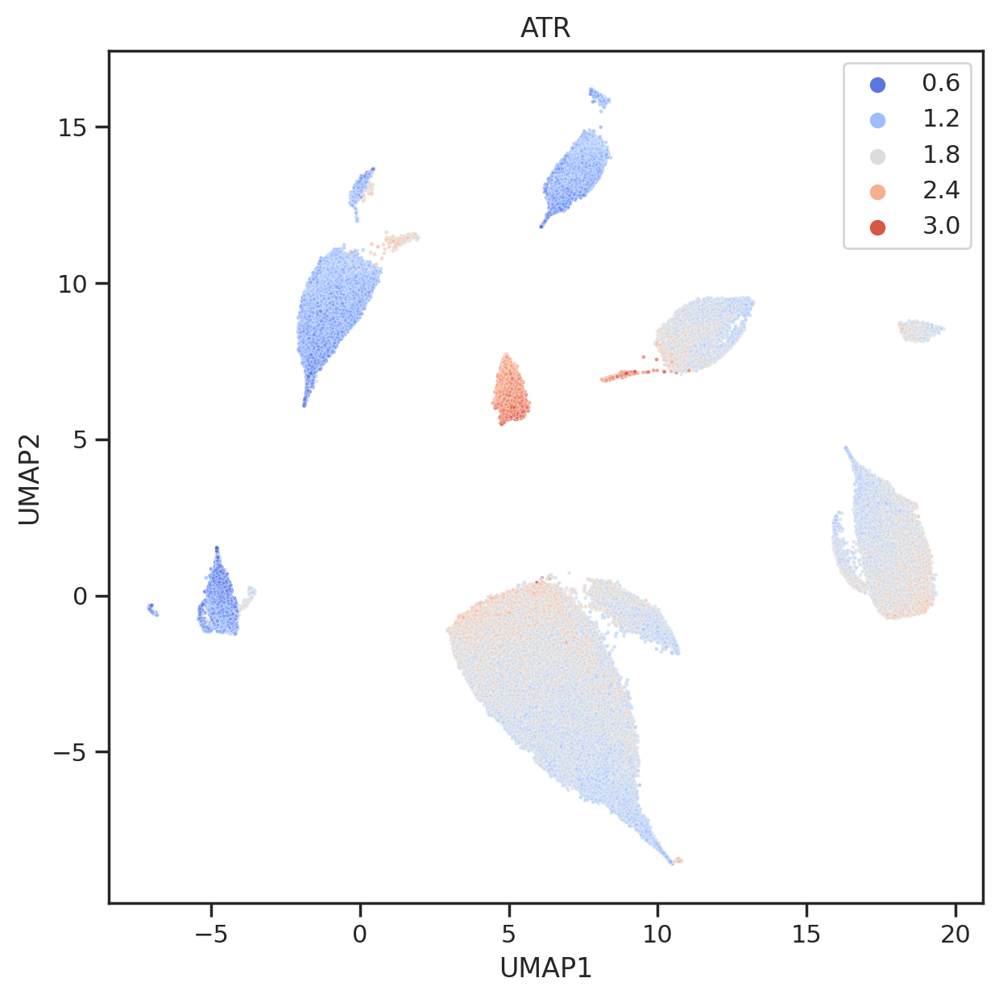

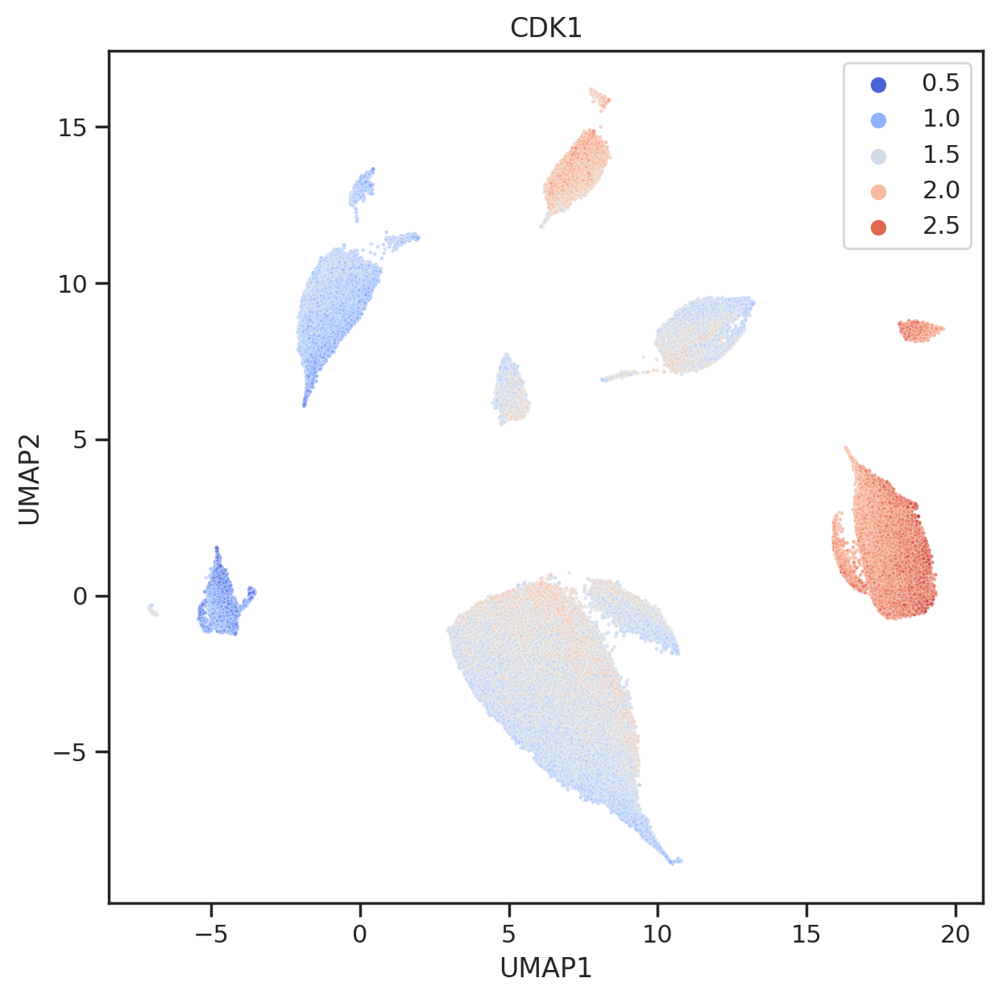

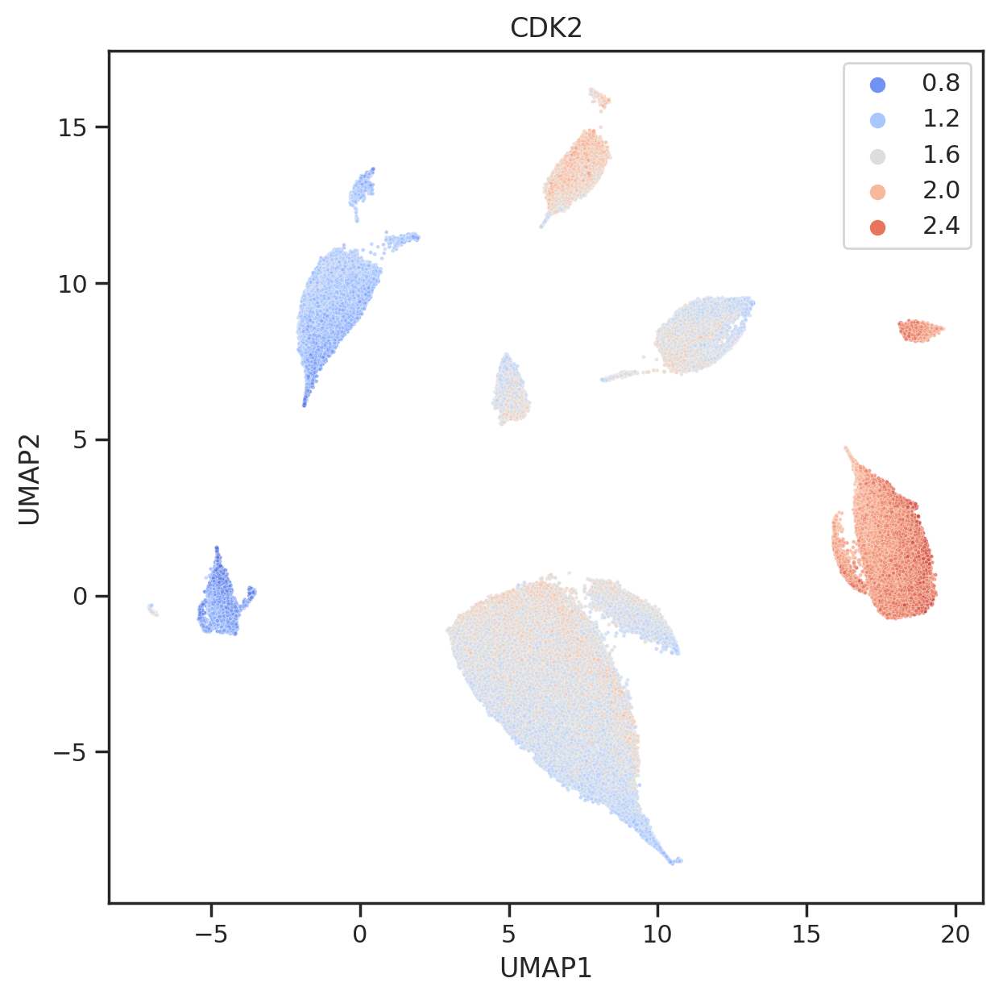

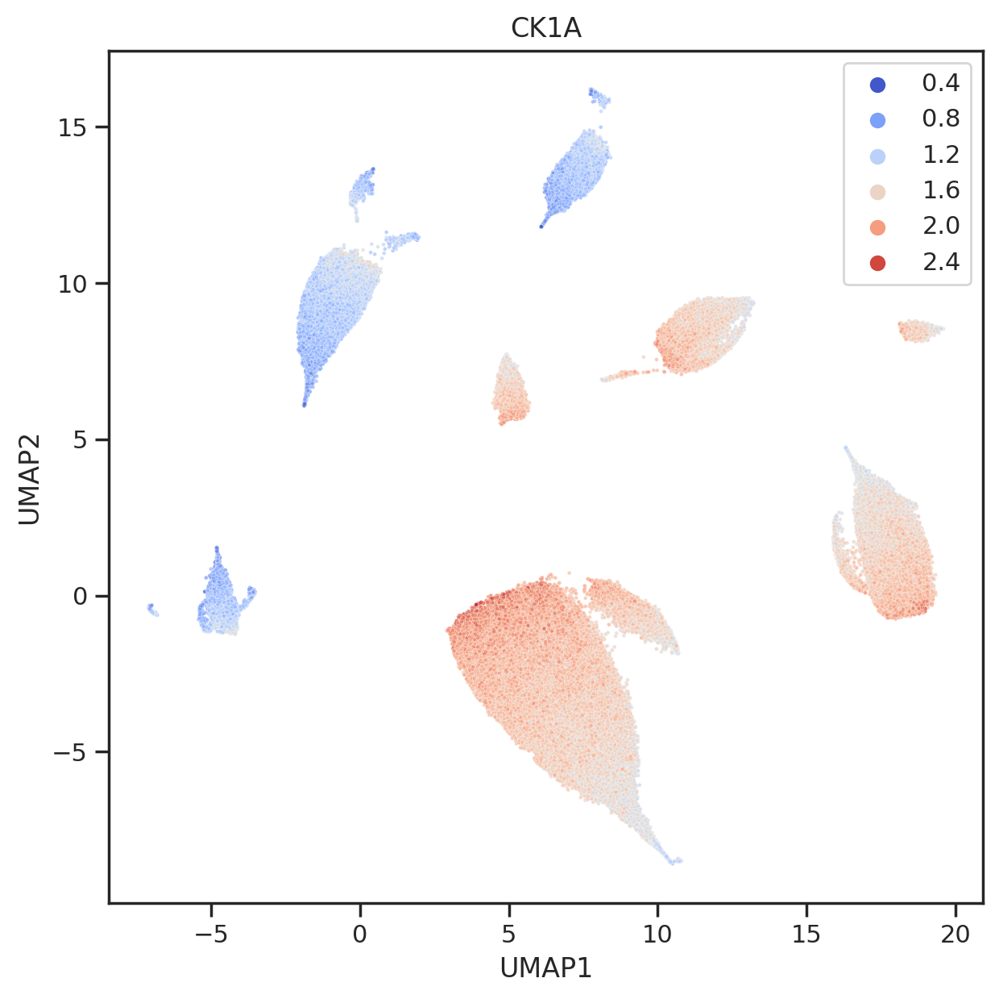

...

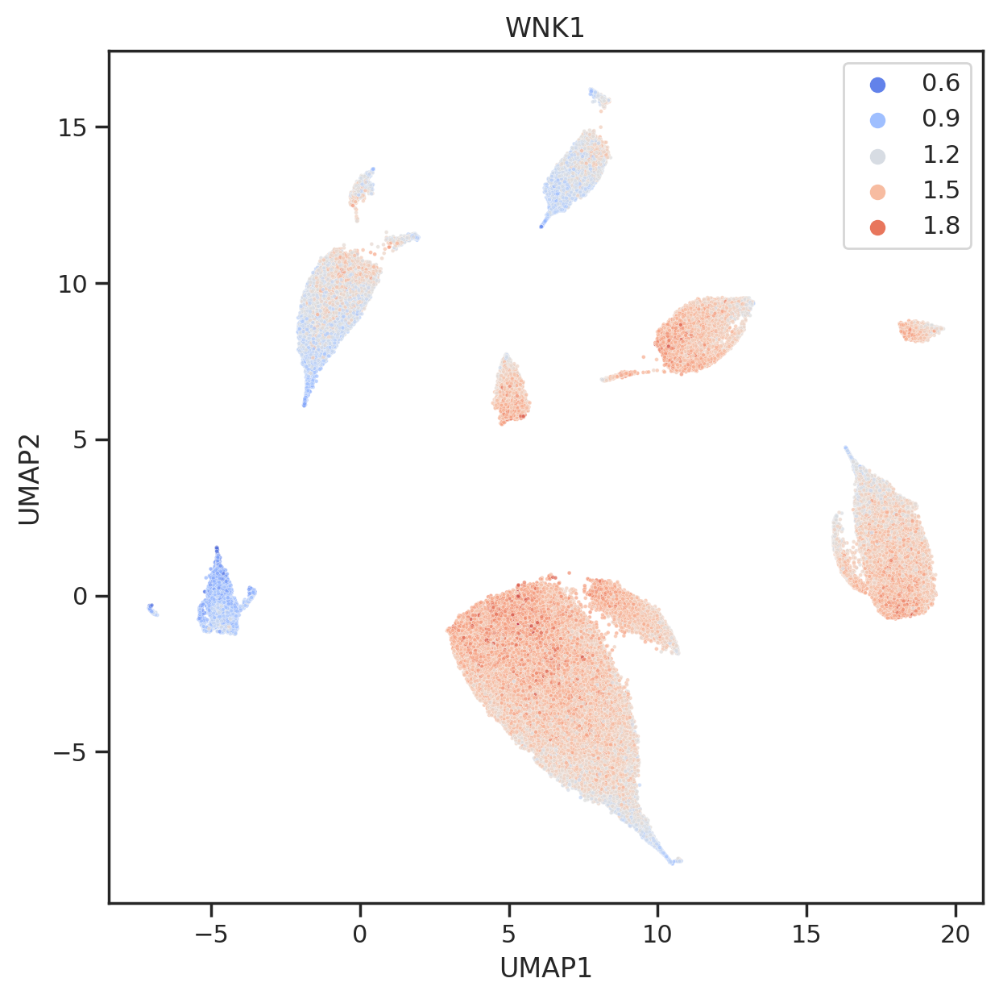

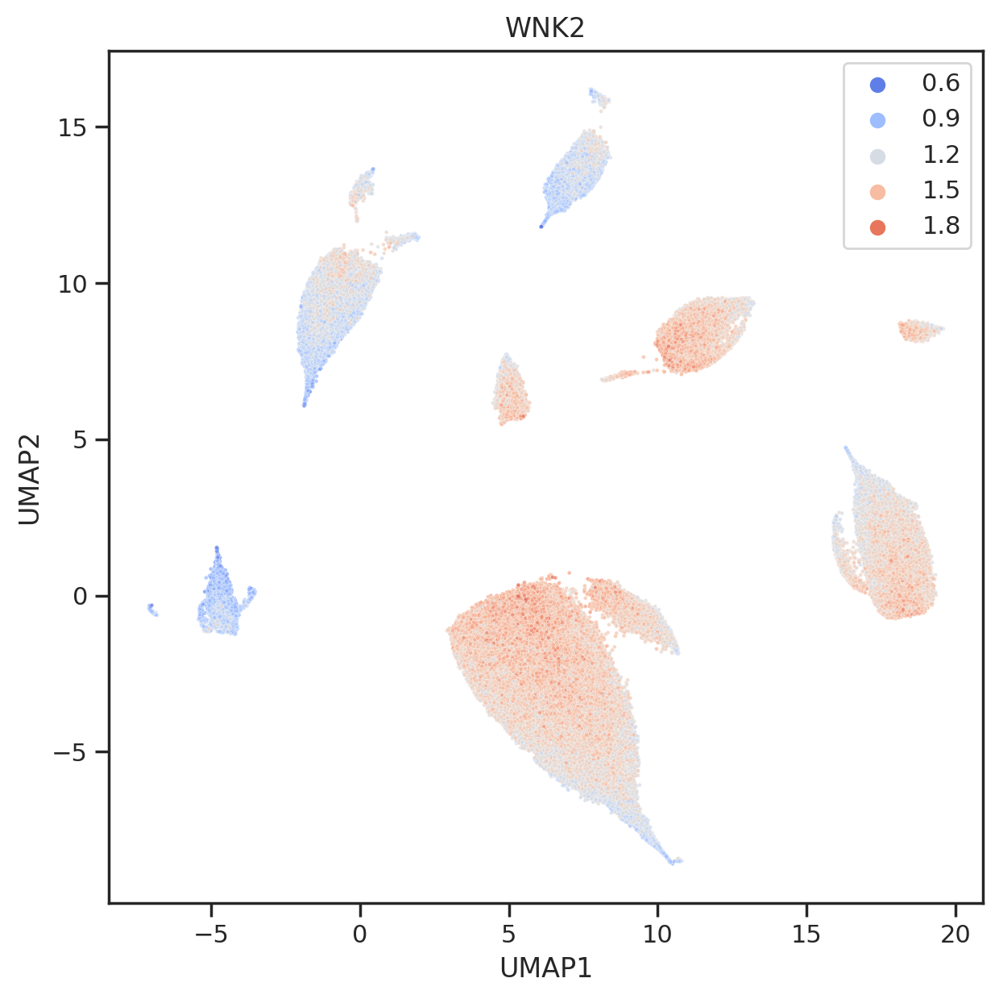

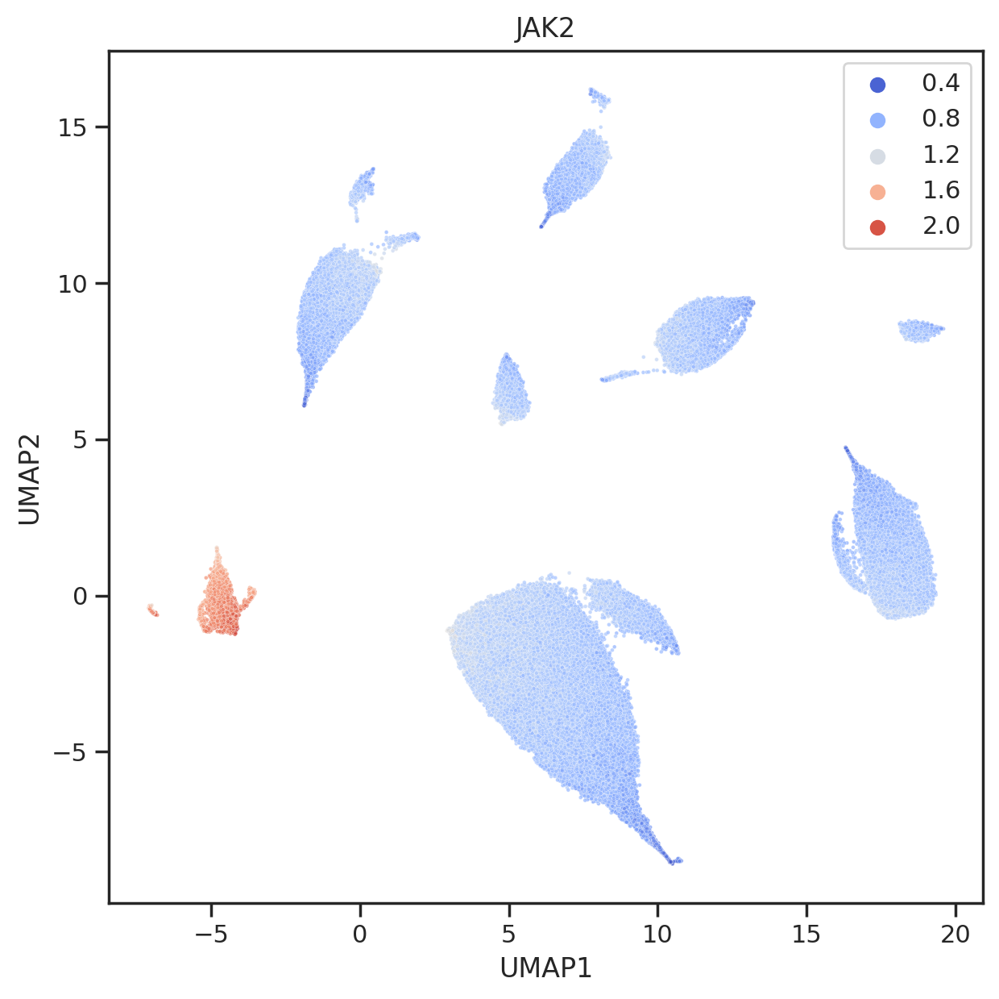

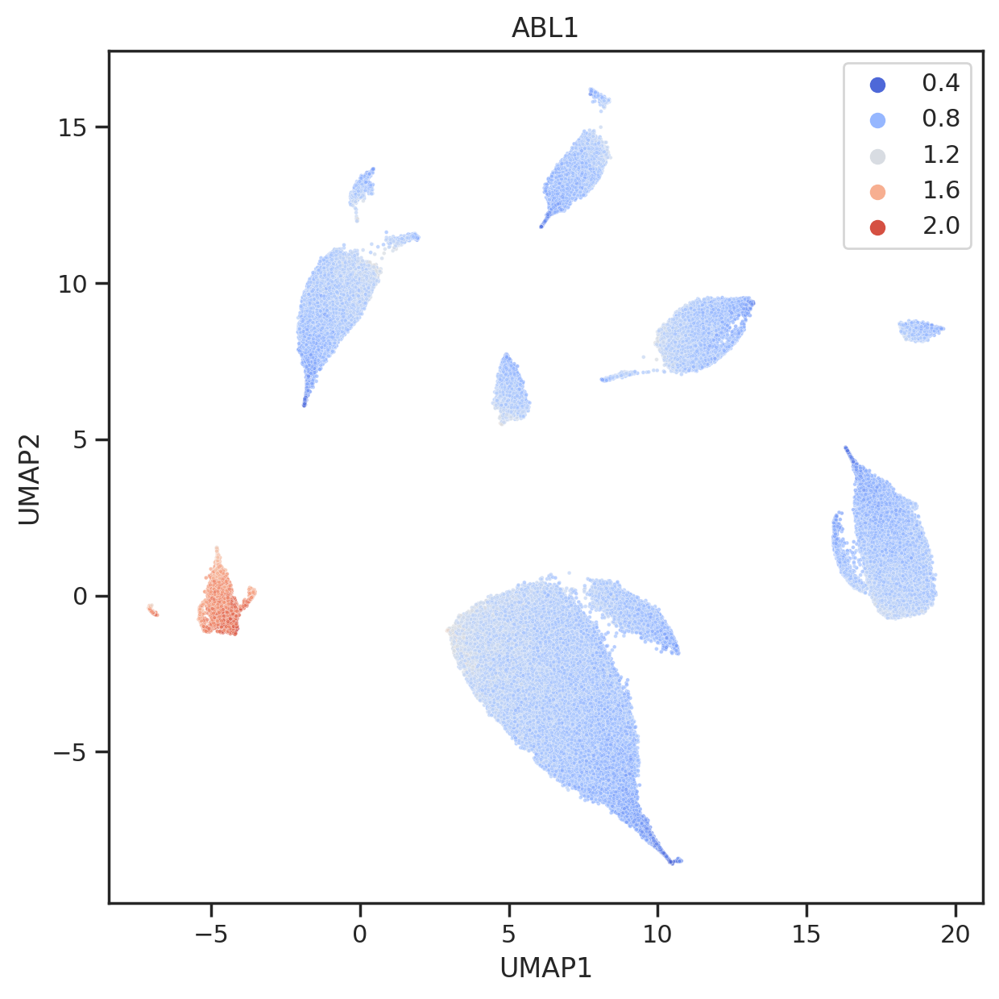

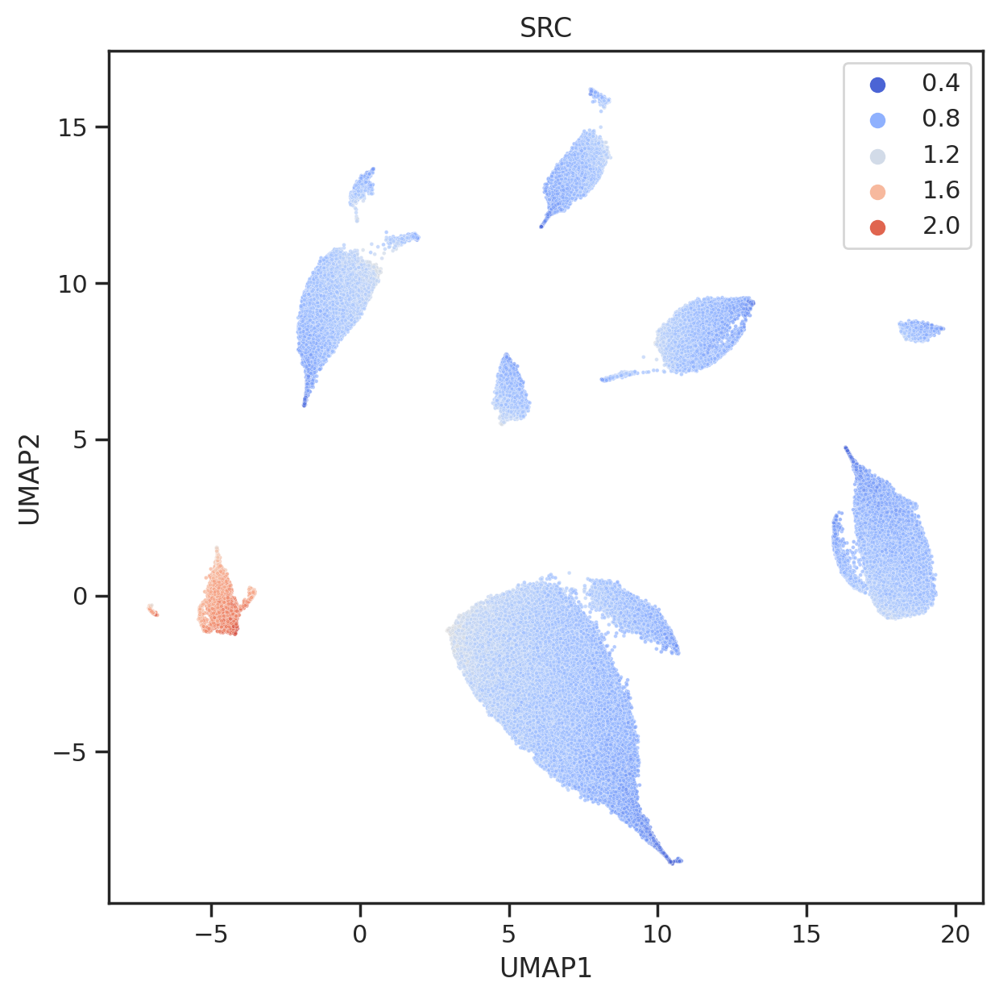

In [ ]:
query_list = ['ATM','ATR', # 1Q, DNA damage
             'CDK1','CDK2', # 1P, proliferation
              'CK1A','CK1G2','GRK5', # acidophilic
              'PKACA','AMPKA1','MAPKAPK3','PAK5','AURB','PKCA', # basophilic
              'WNK1','WNK2', #-2G
              'JAK2','ABL1', 'SRC', # TK
             ]

for i in query_list:
    plot_2d(results_umap,hue=results[i].values,palette='coolwarm')
    plt.title(i)
    plt.show()
    plt.close()

## CPTAC Phenotype comparison

In [ ]:
df = pd.read_csv('unique_site_df.csv')
df.columns = [int(col) if col.lstrip('-').isdigit() else col for col in df.columns]

In [ ]:
def get_max(x):
    x = x.sort_values().values
    if abs(x[0])>abs(x[-1]):
        return x[0]
    else:
        return x[-1]

In [ ]:
sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
sns.set_context('notebook')
sns.set_style("ticks")

In [ ]:
info=Data.get_kinase_info_full().query('pseudo==0')

info = info.rename(columns={'ID_HGNC':'gene'})

In [ ]:
ref = CPTAC.get_id('GBM',is_KB=True)

HTTPError: HTTP Error 503: Service Unavailable

### EGFR_LUAD

all sites


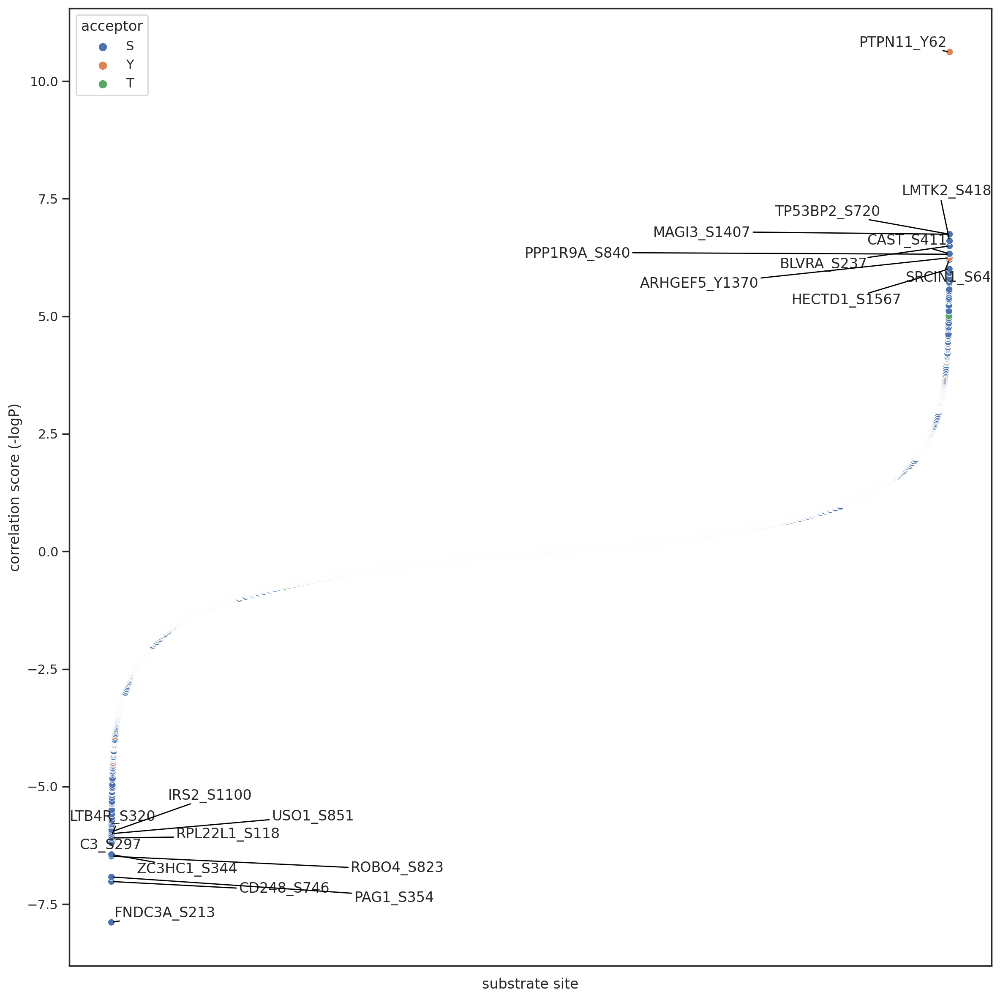

only S/T


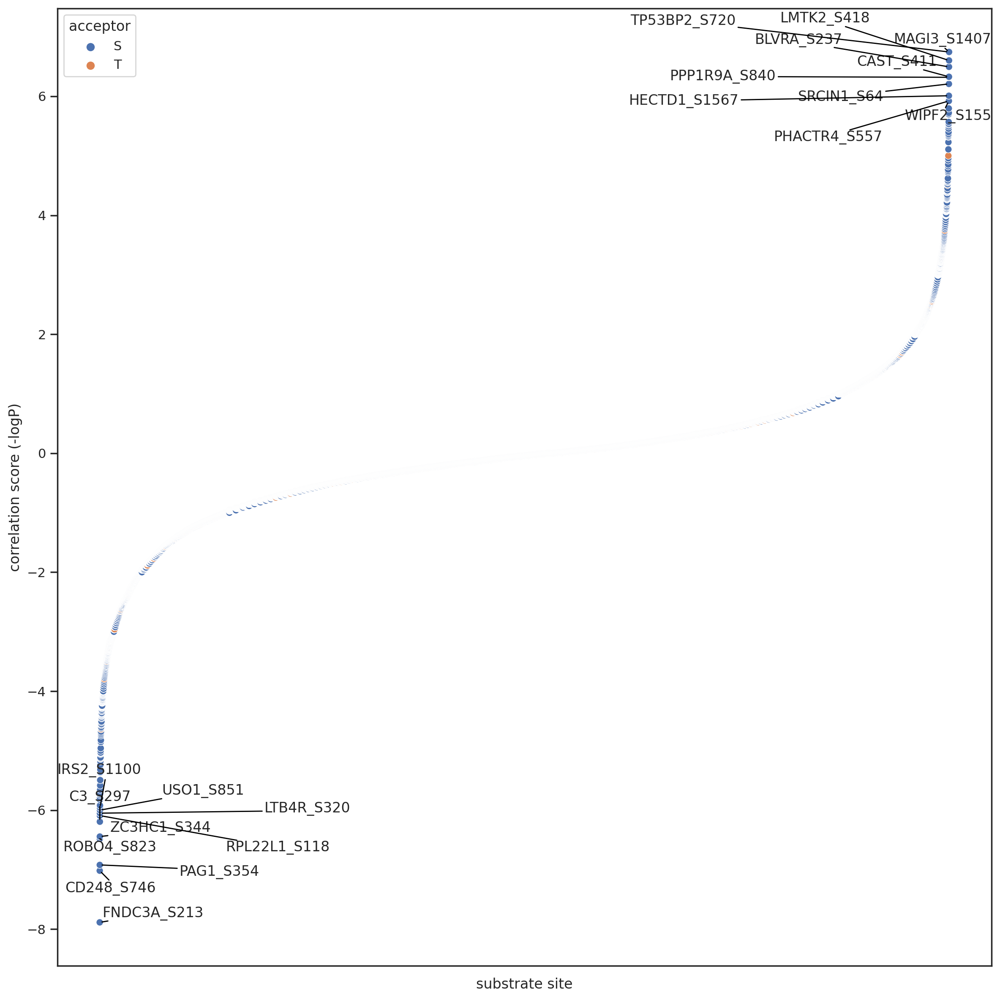

only Y


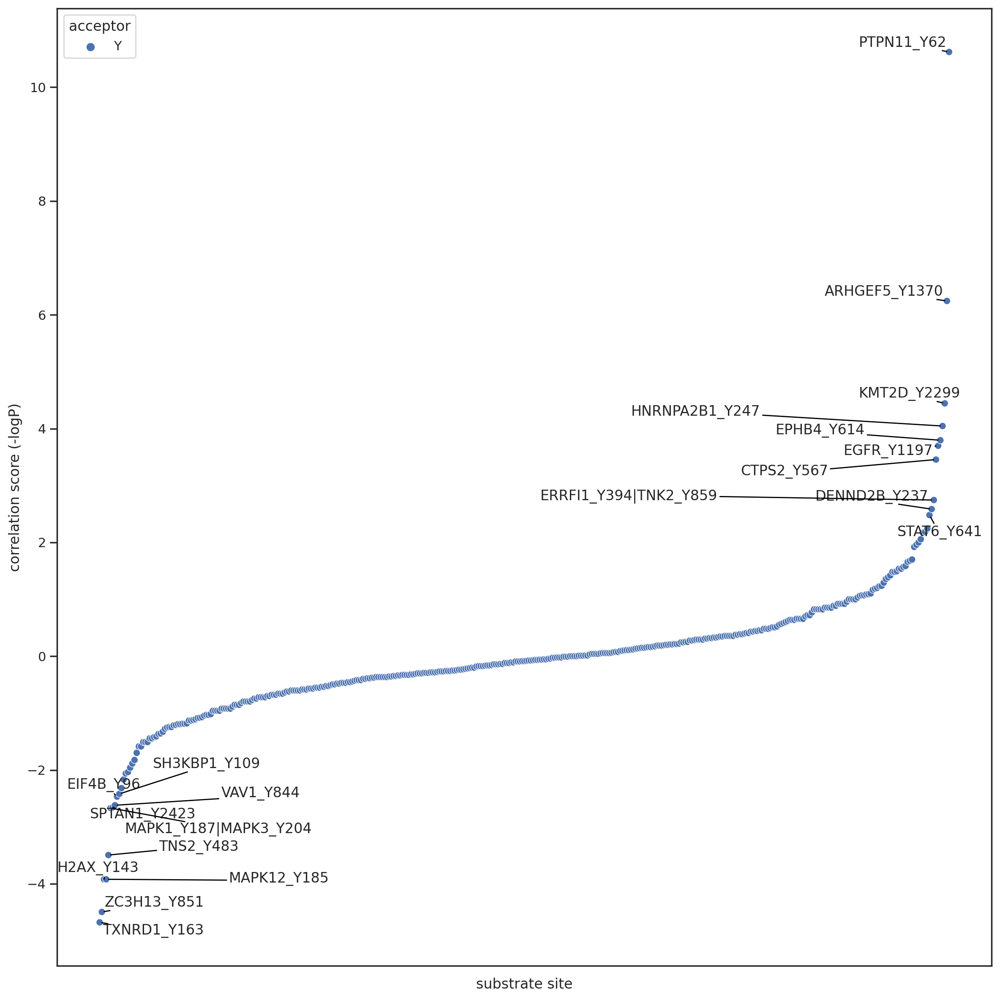

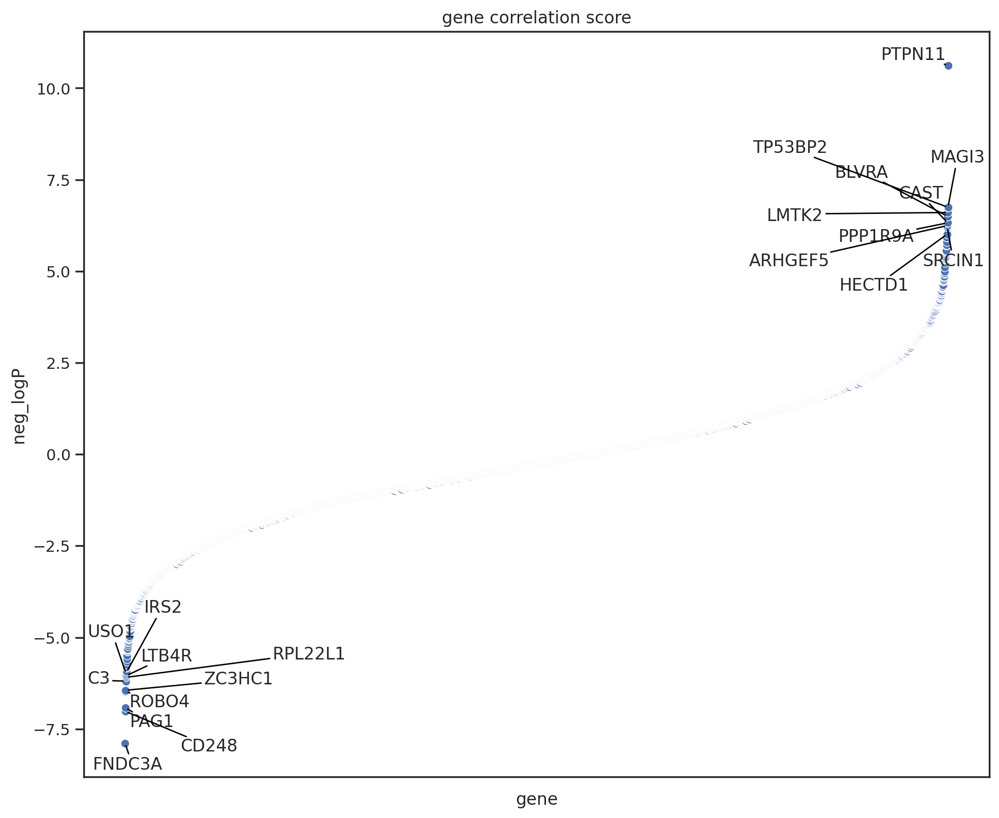

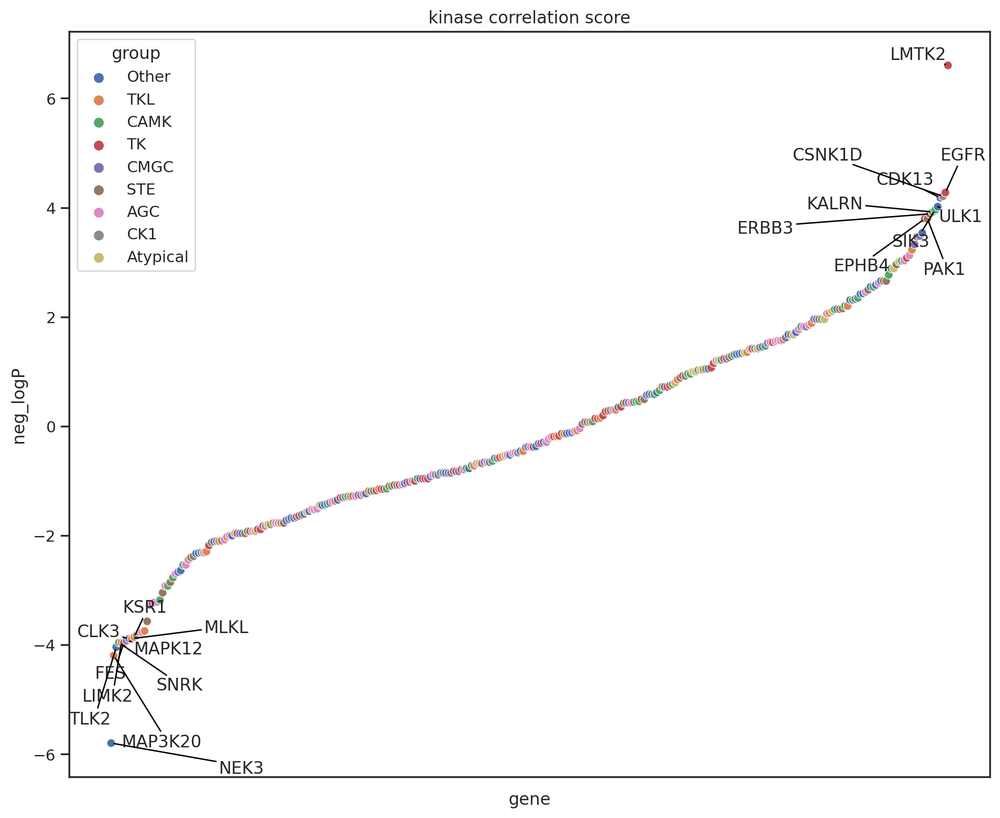

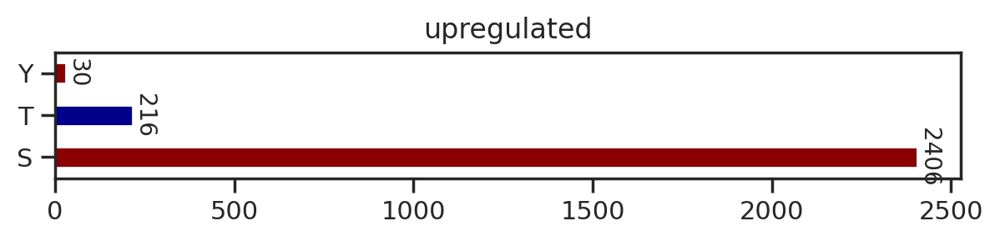

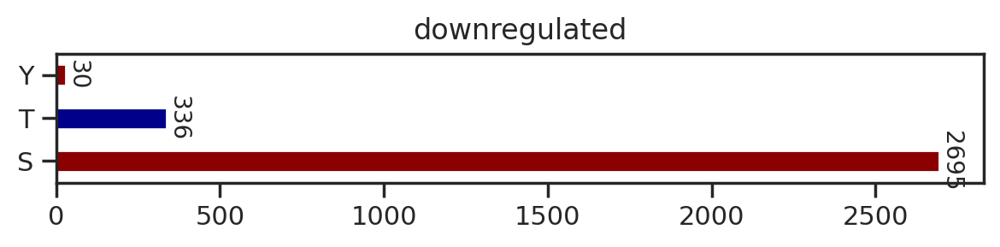

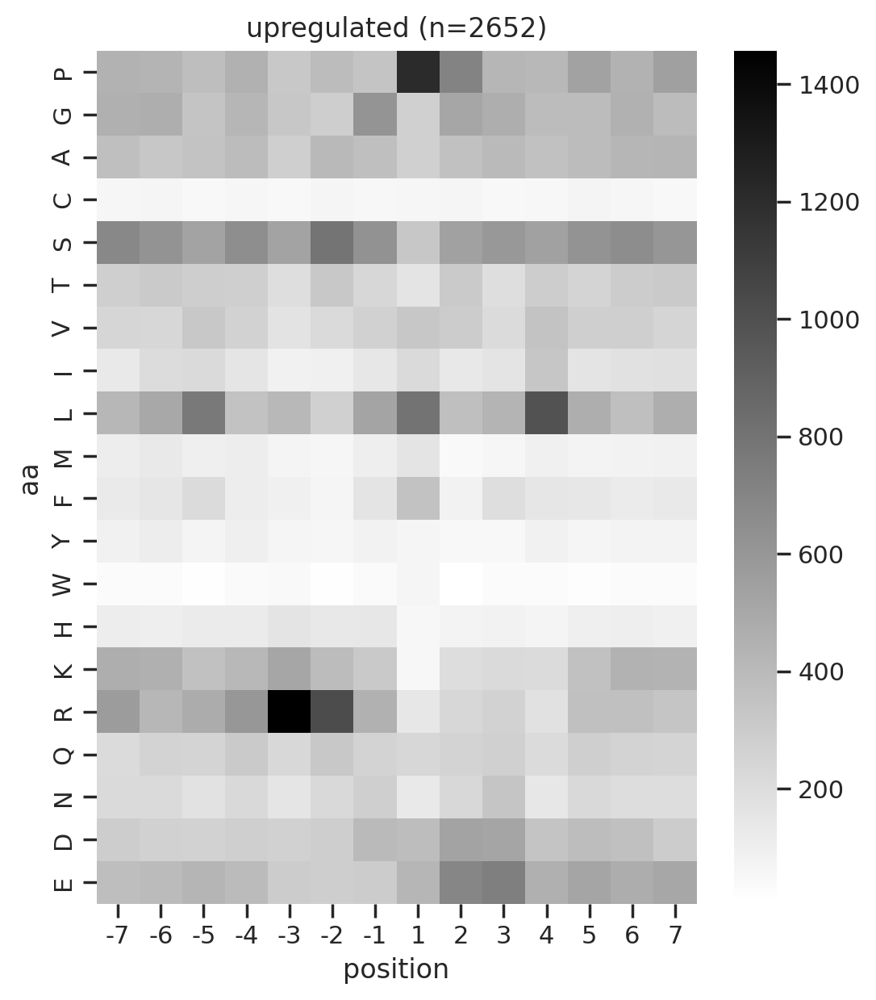

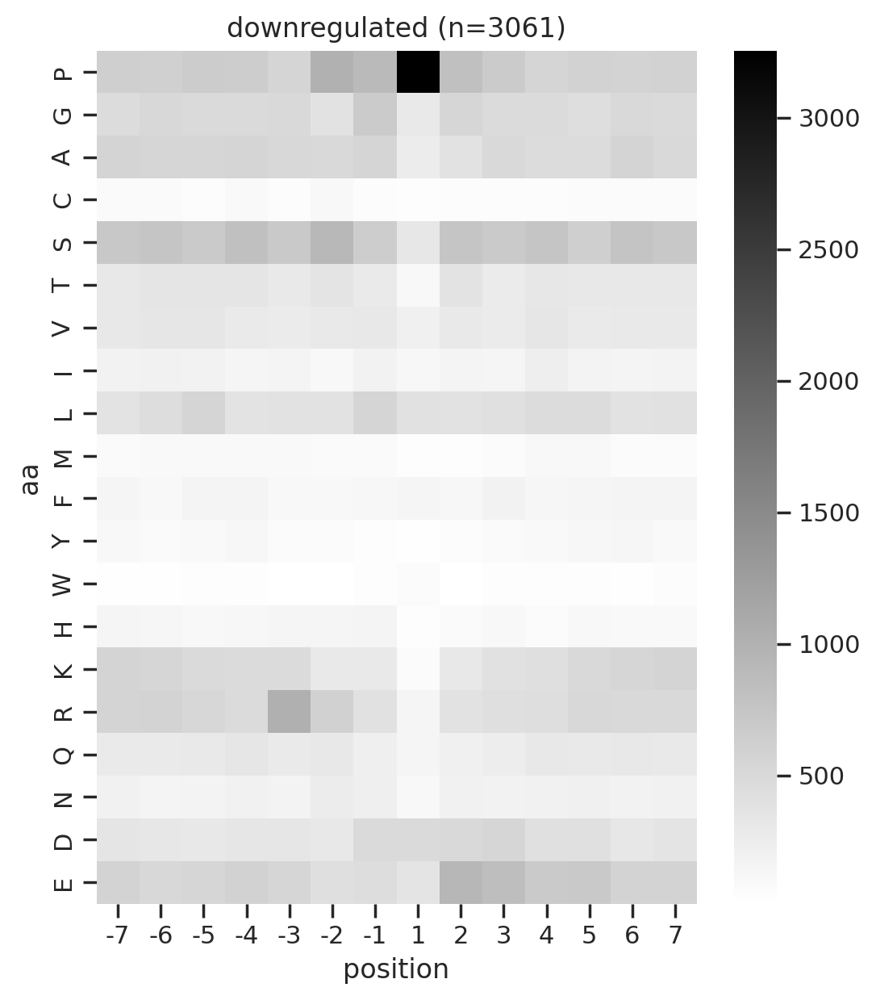

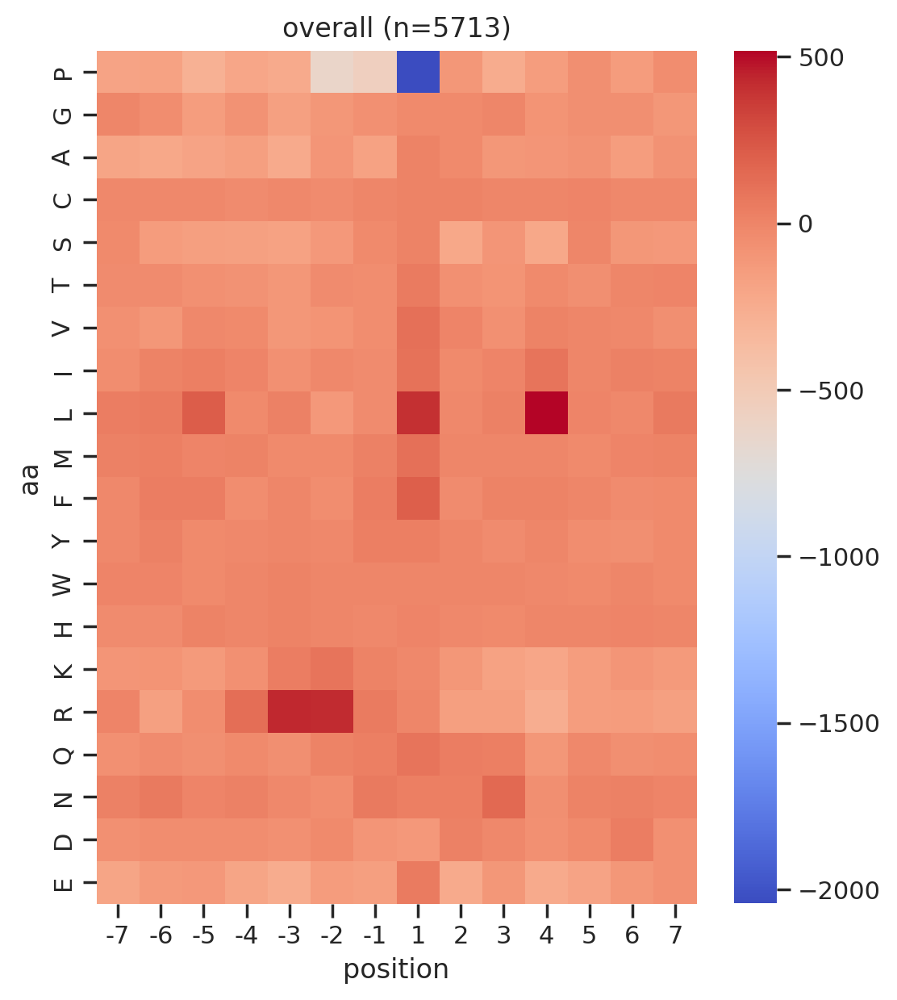

sorted Ser/Thr kinase on s/t phosphosites
ERK2     -3236.689499
CDK1     -3233.408786
ERK1     -3144.891527
CDK2     -3139.025730
CDK5     -3070.394821
             ...     
AKT1     -1007.306694
CAMK1A    -999.033158
DAPK1     -987.822194
LIMK2     -983.694796
WEE1      -965.159313
Length: 213, dtype: float64
sorted tyrosine kinase on y phosphosites
MATK     23.531286
MUSK     23.635403
HCK      24.187357
TNK2     24.513117
NTRK3    24.537529
           ...    
MST1R    27.934804
FGFR3    28.356668
FGFR4    28.548272
EGFR     29.228825
PTK2     30.480823
Length: 76, dtype: float64


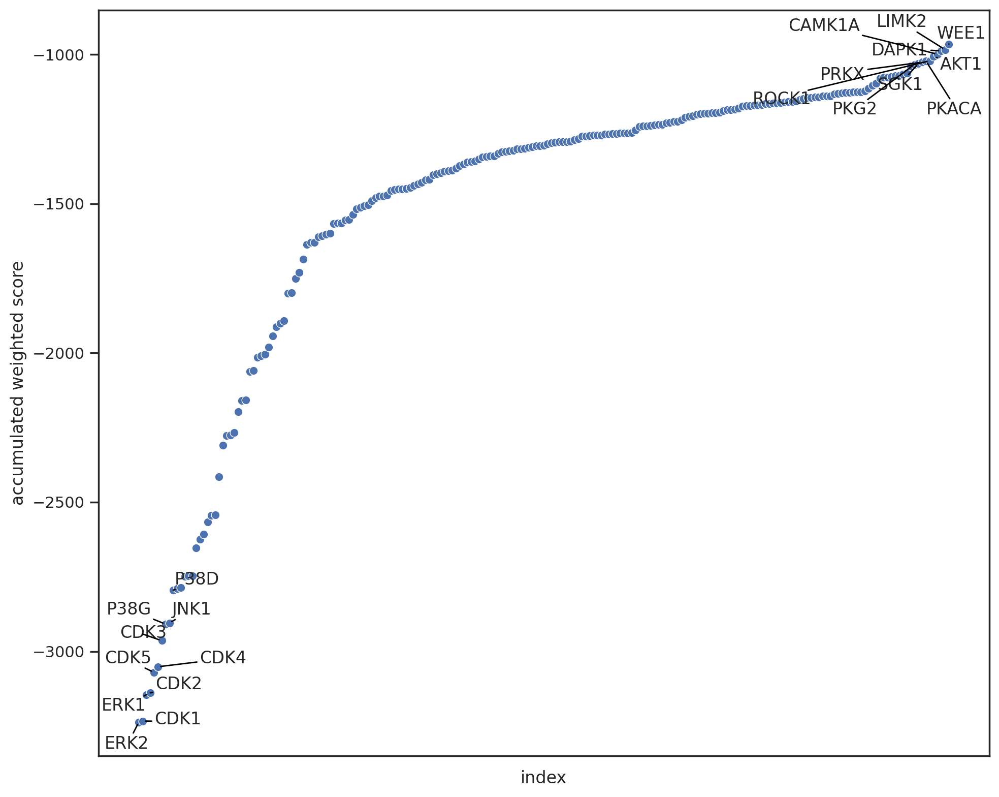

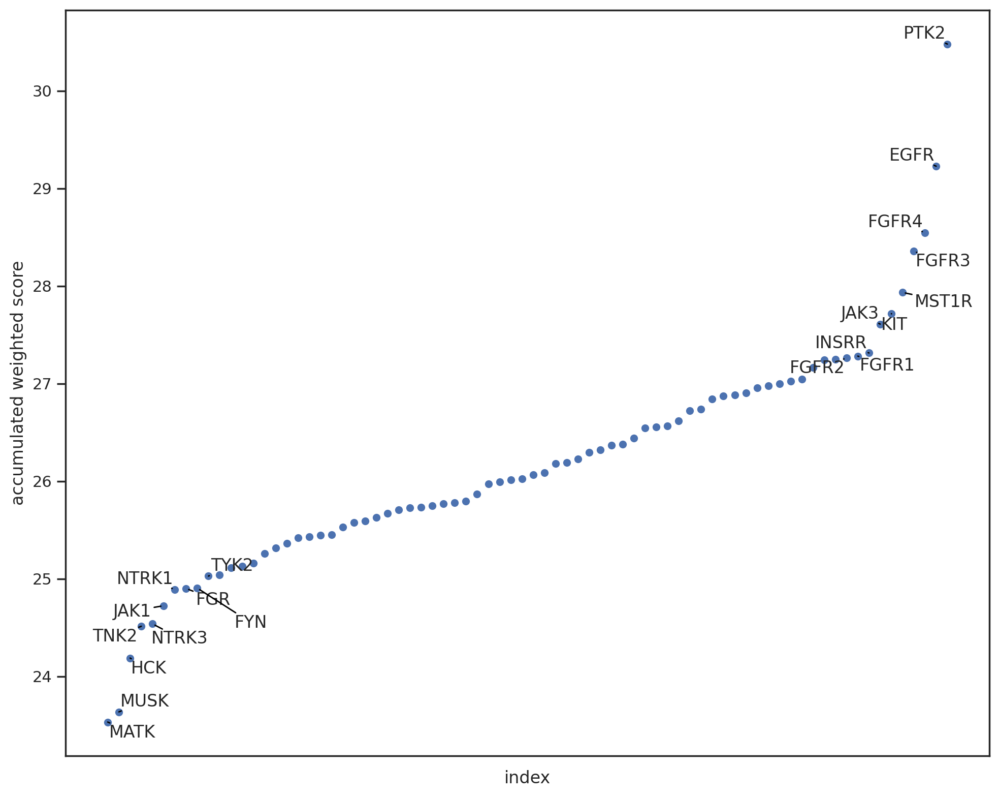

In [ ]:
p = pd.read_csv('EGFR_LUAD.csv').iloc[:,:2]

p = p.merge(ref,'left')

c = p.groupby('site_seq').agg({'neg_logP':'mean'}).reset_index()
c = df.merge(c,'left')
c = c.dropna(subset='neg_logP')


c_results = results.reset_index().loc[c.index]

c = pd.concat([c,c_results.iloc[:,1:]],axis=1)


sorted_df = c.sort_values('neg_logP')

print('all sites')
plot_rank(sorted_df,'gene_site2','neg_logP',figsize=(12,12),hue='acceptor')
plt.ylabel('correlation score (-logP)')
plt.xlabel('substrate site')
# plt.title('Correlation with immune score')
plt.show()
plt.close()


print('only S/T')
c_st = sorted_df.query('acceptor!="Y"')
plot_rank(c_st,'gene_site2','neg_logP',figsize=(12,12),hue='acceptor')
plt.ylabel('correlation score (-logP)')
plt.xlabel('substrate site')
# plt.title('Correlation with immune score')
plt.show()
plt.close()


print('only Y')
c_y = sorted_df.query('acceptor=="Y"')
plot_rank(c_y,'gene_site2','neg_logP',figsize=(12,12),hue='acceptor')
plt.ylabel('correlation score (-logP)')
plt.xlabel('substrate site')
# plt.title('Correlation with immune score')
plt.show()
plt.close()



c['gene'] = c.gene_site2.str.split('_').str[0]
# aggregate by taking the max neg_logP
cnt = c.groupby('gene').agg({'neg_logP':get_max,'gene_site':'count'}).reset_index().sort_values('neg_logP')
# cnt2 = c.groupby('gene').agg({'neg_logP':'max','gene_site':'count'}).reset_index().sort_values('neg_logP')
plot_rank(cnt,y='neg_logP',x='gene')
plt.title('gene correlation score')

# for GSEA pathway analysis
cnt.to_csv('pathway.csv',index=False)



k = cnt[cnt.gene.isin(info.gene)]
k = k.merge(info)
plot_rank(k,y='neg_logP',x='gene',hue='group')
plt.title('kinase correlation score')


hi_condition = 'neg_logP > 1.3'
lo_condition = 'neg_logP < -1.3'

hi = c.query(hi_condition)
lo = c.query(lo_condition)

plot_count(hi,'upregulated')
plt.show()
plt.close()
plot_count(lo,'downregulated')
plt.show()
plt.close()

#up
hi2 = agg_seq(hi,'neg_logP')
hi3 = hi2.drop(columns=[0])
plot_heatmap(hi3,title=f'upregulated (n={len(hi)})',cmap='binary')
plt.show()
plt.close()


#lo
lo2 = agg_seq(lo,'neg_logP')
lo3 = lo2.drop(columns=[0])
plot_heatmap(-lo3,title=f'downregulated (n={len(lo)})',cmap='binary')
plt.show()
plt.close()

#all
enrich = pd.concat([hi,lo],axis=0)
cc = agg_seq(enrich,'neg_logP')
ccc = cc.drop(columns=[0])
plot_heatmap(ccc,title=f'overall (n={len(enrich)})',cmap='coolwarm')
plt.show()
plt.close()

#----------------------------------------------------------
# define ser/thr kinase columns
stk = info.query('group!="TK"').kinase
stk_cols = c.columns[c.columns.isin(stk)]

# get enriched ser/thr site score
c_st_enrich = pd.concat([c_st.query(hi_condition),c_st.query(lo_condition)],
          axis=0)
c_st_w_enrich = c_st_enrich.iloc[:,-289:].multiply(c_st_enrich.neg_logP, axis=0)

print('sorted Ser/Thr kinase on s/t phosphosites')
print(c_st_w_enrich[stk_cols].sum().sort_values())

# make the rank plot for ser/thr kinase
sort_st = c_st_w_enrich[stk_cols].sum().sort_values()
sort_st = sort_st.reset_index(name='accumulated weighted score')
plot_rank(sort_st,x='index',y='accumulated weighted score')


#------------------------------------------------------
# define tyrosine kinase columns
tk = info.query('group=="TK"').kinase
tk_cols = c.columns[c.columns.isin(tk)]

# get enriched tyrosine site score
c_y_enrich = pd.concat([c_y.query(hi_condition),c_y.query(lo_condition)],
          axis=0)
c_y_w_enrich = c_y_enrich.iloc[:,-289:].multiply(c_y_enrich.neg_logP, axis=0)

print('sorted tyrosine kinase on y phosphosites')
print(c_y_w_enrich[tk_cols].sum().sort_values())

# make the rank plot for TK
sort_y = c_y_w_enrich[tk_cols].sum().sort_values()
sort_y = sort_y.reset_index(name='accumulated weighted score')
plot_rank(sort_y,x='index',y='accumulated weighted score')

# print('enriched kinase in y up')
# print(c_y.query(hi_condition).iloc[:,-289:].quantile(0.90).sort_values(ascending=False))

# print('enriched kinase in y lo')
# print(c_y.query(lo_condition).iloc[:,-289:].quantile(0.90).sort_values())

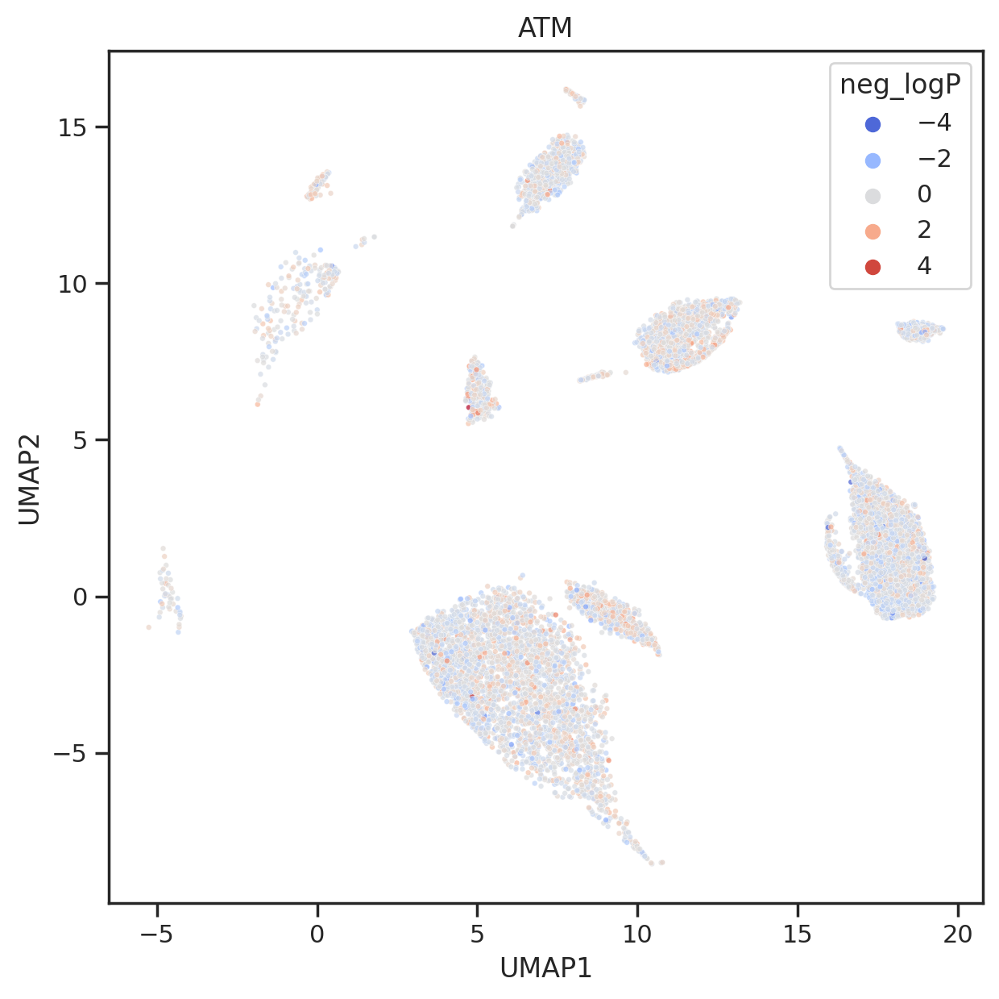

In [ ]:

plot_2d(results_umap,hue=c.neg_logP,palette='coolwarm')
plt.title(i)
plt.show()
plt.close()

In [ ]:
results_umap.query('2.5<UMAP1<7.5 and 5<UMAP2<10').index

Int64Index([     6,     14,     17,     19,     43,    101,    105,    114,
               165,    169,
            ...
            125271, 125273, 125298, 125301, 125524, 125588, 125596, 125611,
            125622, 125627],
           dtype='int64', length=3788)

In [ ]:
c = results_umap.query('2.5<UMAP1<7.5 and 5<UMAP2<10').index

In [ ]:
c

Int64Index([     6,     14,     17,     19,     43,    101,    105,    114,
               165,    169,
            ...
            125271, 125273, 125298, 125301, 125524, 125588, 125596, 125611,
            125622, 125627],
           dtype='int64', length=3788)

In [ ]:
c = results['ATM'].sort_values()

In [ ]:
pd.DataFrame(c[c>2.25].index.str.split('_').str[0]).drop_duplicates().to_csv('atm_top.csv')

In [ ]:
atm = df[df.index.isin(c)]

In [ ]:
atm.gene_site2.str.split('|').str[0].str.split('_').str[0].value_counts()

FLG         20
TP53BP1     16
TNKS1BP1    15
TLN1        11
TTN         11
            ..
PAPPA        1
GTF2H4       1
HDGF         1
CETN2        1
GCLC         1
Name: gene_site2, Length: 2496, dtype: int64

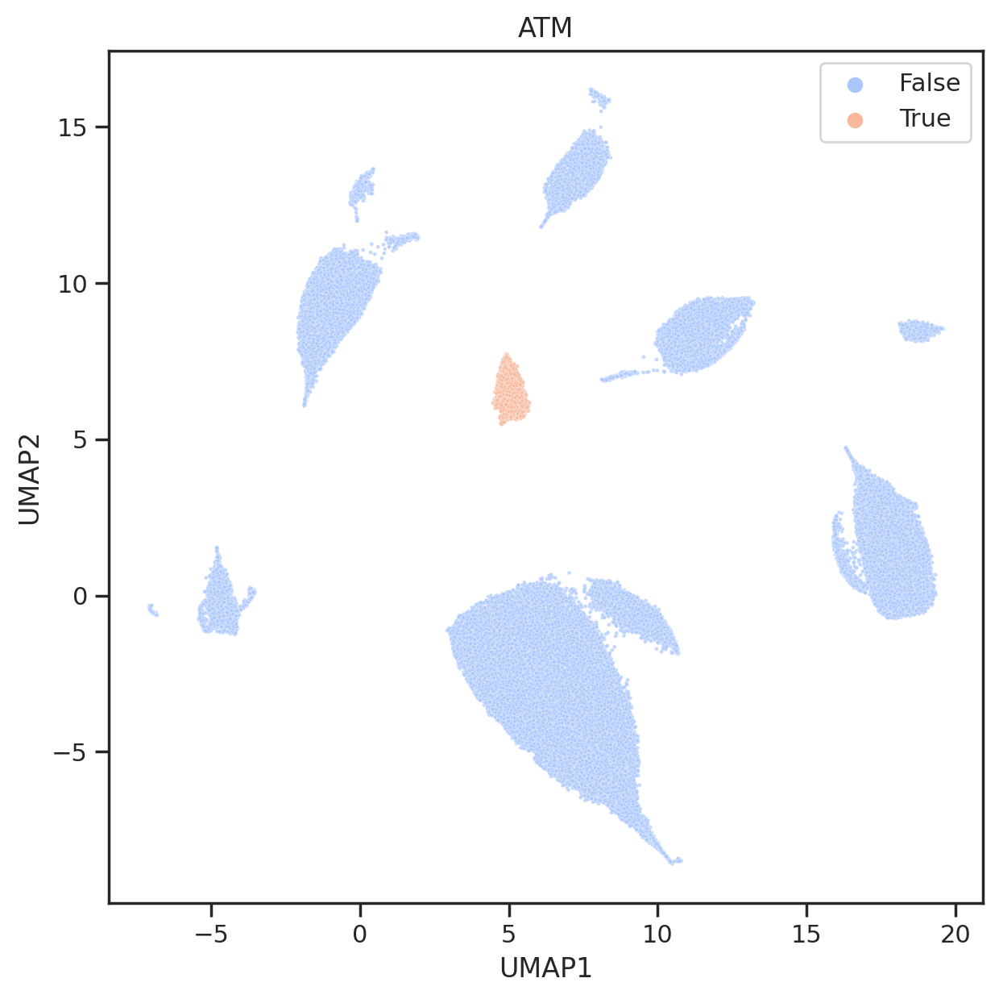

In [ ]:
for i in ['ATM']:
    plot_2d(results_umap,hue=df.index.isin(c),palette='coolwarm')
    plt.title(i)
    plt.show()
    plt.close()

In [ ]:
results

kinase,SRC,EPHA3,FES,NTRK3,ALK,EPHA8,ABL1,FLT3,EPHB2,FYN,RET,PKACA,EPHB1,MUSK,INSR,EPHB3,FER,EPHB4,NTRK1,ROS1,TYRO3,SYK,TNK1,YES1,MET,BMX,FLT4,LTK,FRK,ERK2,LCK,FGFR1,MST1R,EPHA5,FGFR2,CDK1,TEK,IKKB,FGR,JAK3,LYN,SRMS,TEC,EPHA2,EPHA1,PDGFRA,INSRR,IGF1R,ERK1,BTK,AXL,PKCA,EPHA7,CDK2,ERBB4,MERTK,BLK,JAK2,PTK6,HCK,ABL2,JNK1,P38A,MLK1,PDGFRB,EPHA6,KDR,NEK6,PLK1,CK2A1,PTK2B,EGFR,DYRK2,P38D,HGK,TTBK1,MST3,NTRK2,MST1,IKKE,MST2,CSF1R,MINK,DDR2,NEK7,NEK2,TXK,ZAP70,CDK5,NEK1,MST4,QIK,P38G,KIT,CHK1,CAMK2A,KHS1,FGFR3,YSK1,CK1D,AKT1,RSK3,NEK4,GSK3B,TNIK,ITK,MAPKAPK3,TAO2,AURB,NIM1,FGFR4,MLK3,PAK3,FLT1,AURA,PIM1,EPHA4,AURC,MSK1,MARK4,CAMK2G,PLK3,ZAK,NEK9,P70S6K,PAK1,SGK3,MARK2,GCK,MLK2,PAK2,MEKK1,TBK1,CAMK2D,P90RSK,PHKG2,DYRK3,IKKA,P38B,TSSK1,ERK5,PIM3,TLK1,TAK1,JNK2,NLK,LIMK1,MAPKAPK5,SIK,DCAMKL2,MATK,AMPKA1,MAPKAPK2,CK2A2,CDK9,PKCB,JNK3,ALK4,IRAK1,RSK4,TNK2,IRAK4,DSTYK,CAMK2B,PKACB,PRKD3,PKCT,MARK1,MNK2,SGK1,DYRK4,MARK3,TAO1,TLK2,TSSK2,CK1E,PKG2,PRKD1,RSK2,AKT2,BUB1B,ULK3,DAPK1,GRK2,ROCK1,BMPR1B,PTK2,NEK11,LATS2,DYRK1A,CSK,CK1G2,CDK6,CK1A,PKCZ,GRK5,WNK3,ROCK2,ALK2,CAMKK1,ATM,PKG1,TGFBR1,AMPKA2,TYK2,PKN1,PKCG,MSK2,JAK1,NUAK2,GRK7,LKB1,WNK1,AKT3,PKCD,ICK,PBK,SKMLCK,LATS1,SGK2,WNK2,CAMK4,CK1G1,PRKD2,PLK4,PKCH,WEE1,CDK3,CHK2,CDK7,PKCE,CK1G3,PKCI,SLK,PRKX,DCAMKL1,EEF2K,MELK,CAMKK2,MEK2,HIPK2,CDK4,MTOR,PAK6,GSK3A,MOK,NDR1,NUAK1,PIM2,MEK1,TESK1,ERK7,NDR2,OSR1,CLK1,COT,ACVR2A,HIPK4,MEKK2,LRRK2,PHKG1,MAP2K4,PAK5,PERK,MOS,DNAPK,P70S6KB,CLK3,LIMK2,BRSK2,PAK4,STLK3,CAMK1A,CAMK1D,HASPIN,HIPK1,ASK1,ATR,MPSK1,MEK5,PKN2,MAP2K7,MRCKB,HIPK3,CDK8,BUB1,MEKK3,MAP2K3,GRK1
gene_site2,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ZBTB7A_S182,0.796563,0.779769,0.819841,0.963711,0.858688,0.754362,0.852700,0.840211,0.808867,0.766546,0.797308,1.768850,0.843462,0.879759,0.893456,0.811482,0.844492,0.815716,0.948659,0.883217,0.844688,0.813475,0.845922,0.767012,0.868566,0.805608,0.917525,0.809724,0.751722,1.697679,0.770129,0.856083,0.820181,0.775035,0.823884,1.558929,0.839418,1.712834,0.795359,0.916459,0.812857,0.805805,0.748316,0.790237,0.791171,0.893450,0.819866,0.912480,1.672840,0.813433,0.803114,1.670261,0.804066,1.621888,0.813100,0.838773,0.751520,0.873723,0.810792,0.813464,0.792473,1.596907,1.604978,1.541966,0.897439,0.811127,0.880569,1.551523,1.536153,1.610534,0.812010,0.786216,1.708458,1.557329,1.251667,1.544790,1.261957,0.822281,1.188482,1.706899,1.185148,0.770371,1.198892,0.753345,1.644103,1.567859,0.813209,0.786429,1.628837,1.290005,1.272203,1.751609,1.589232,0.785305,1.531981,1.625854,1.367075,0.833119,1.303420,1.656714,1.656993,1.681864,1.215529,1.854729,1.265482,0.842931,1.708211,1.395693,1.662163,1.782779,0.806515,1.533864,1.644513,0.841536,1.661102,1.498191,0.729775,1.559254,1.681286,1.682493,1.584014,1.490132,1.414198,1.655556,1.590762,1.646693,1.748441,1.748726,1.174817,1.479028,1.649889,1.341576,1.801925,1.573778,1.682235,1.822432,1.610495,1.731358,1.590541,1.812264,1.703905,1.526507,1.419416,1.067177,1.477187,1.493945,1.110575,1.701888,1.803249,1.537489,1.074437,1.688461,1.760588,1.608373,1.775426,1.747019,1.590898,1.467025,1.534882,1.609536,0.865440,1.395347,1.533312,1.657885,1.792198,1.779332,1.727536,1.764313,1.879894,1.530102,1.695232,1.790397,1.256849,1.385763,1.872214,1.731224,1.615945,1.803823,1.636168,1.667560,1.530259,1.979309,1.215971,1.436782,1.332652,1.388275,0.809304,1.328055,1.683769,1.666208,0.793479,1.651467,1.507196,1.651573,1.751062,1.469975,1.654792,1.327924,1.518045,1.290941,1.609669,1.736168,1.445218,1.824795,0.850188,1.775595,1.837006,1.746311,0.802827,1.907408,1.510369,1.190030,1.617984,1.659365,1.614829,1.481655,1.172357,1.584221,1.658460,1.595821,1.507848,1.789679,1.498264,1.744235,1.511905,1.673671,0.745687,1.598170,1.546534,1.705501,1.841034,1.459109,1.564304,1.459789,1.893978,1.755656,1.

In [ ]:
df

,site_seq,gene_site,num,gene_site2,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,acceptor,c-3,c-2,c+1,c+3,cluster,cluster2,cluster3
0,AAAAAAASFPWSAFG,[ZBTB7A_S182],1,ZBTB7A_S182,A,A,A,A,A,A,A,S,F,P,W,S,A,F,G,S,,,,,others,others,others
1,AAAAAAASGAAGGGG,[INTS3_S16],1,INTS3_S16,A,A,A,A,A,A,A,S,G,A,A,G,G,G,G,S,,,,,others,others,others
2,AAAAAAASGALLGAY,[TMEM64_S62],1,TMEM64_S62,A,A,A,A,A,A,A,S,G,A,L,L,G,A,Y,S,,,,,others,others,others
3,AAAAAAASGGAGSDN,[PBX1_S136],1,PBX1_S136,A,A,A,A,A,A,A,S,G,G,A,G,S,D,N,S,,,,,others,others,others
4,AAAAAAASGGGVSPD,[PBX2_S146],1,PBX2_S146,A,A,A,A,A,A,A,S,G,G,G,V,S,P,D,S,,,,,others,others,others
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125853,______MTMETLPKV,[PIRT_T2],1,PIRT_T2,_,_,_,_,_,_,M,T,M,E,T,L,P,K,V,T,,,,,others,others,others
125854,______MTPPPPPPP,[ESRP2_T2],1,ESRP2_T2,_,_,_,_,_,_,M,T,P,P,P,P,P,P,P,T,,,+1P,+3P,+1P|+3P,+1P|+3P,+1P|+3P
125855,______MTVSGPGTP,[UNC45A_T2],1,UNC45A_T2,_,_,_,_,_,_,M,T,V,S,G,P,G,T,P,T,,,,,others,others,others
125856,______MYPAGPPAG,[TIGD5_Y2],1,TIGD5_Y2,_,_,_,_,_,_,M,Y,P,A,G,P,P,A,G,Y,,,+1P,,+1P,+1P,+1P


In [ ]:
results_umap = reduce_feature(results,'umap',complexity=15)

/usr/local/lib/python3.9/dist-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [ ]:
results_umap = results_umap.reset_index(drop=True)

In [ ]:
def plot_2d(X,**kwargs):
    plt.figure(figsize=(7,7))
    sns.scatterplot(data = X,x=X.columns[0],y=X.columns[1],s=3,alpha=0.7,**kwargs)

Text(0.5, 1.0, 'position -3')

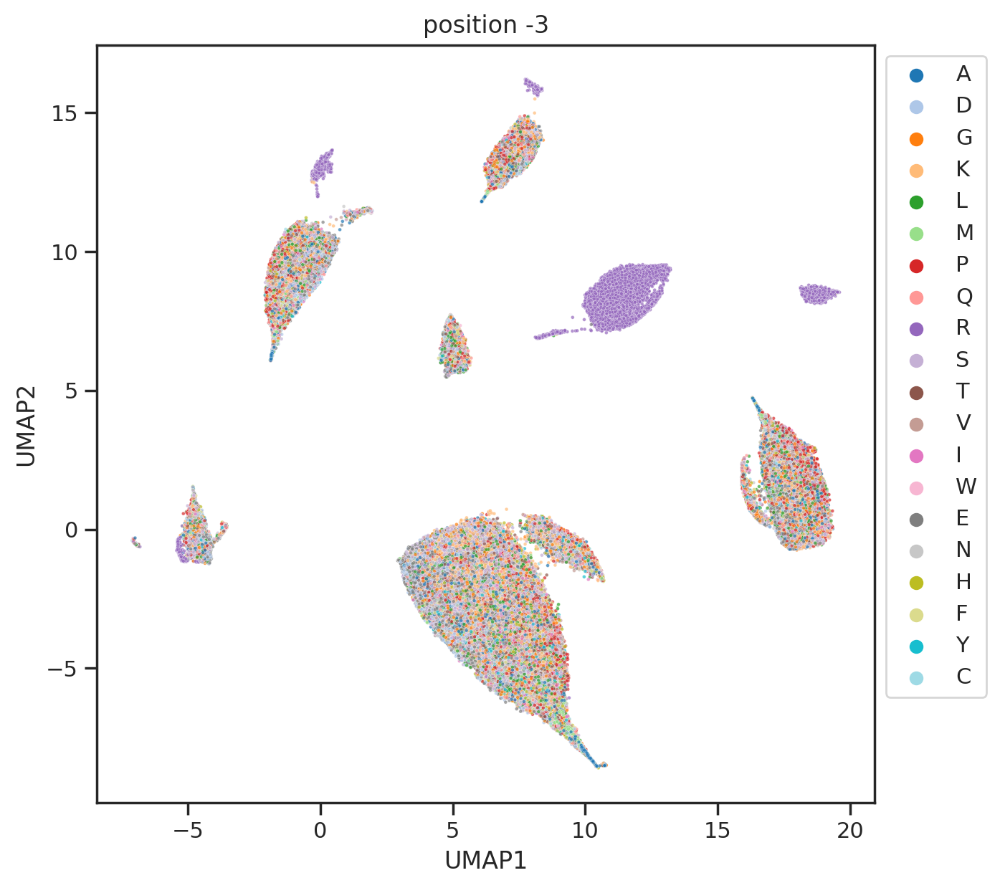

In [ ]:
plot_2d(results_umap,hue=unique_site.site_seq.str[4],palette='tab20')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.title('position -3')

In [ ]:
plot_2d(results_umap,hue=unique_site.site_seq.str[7])

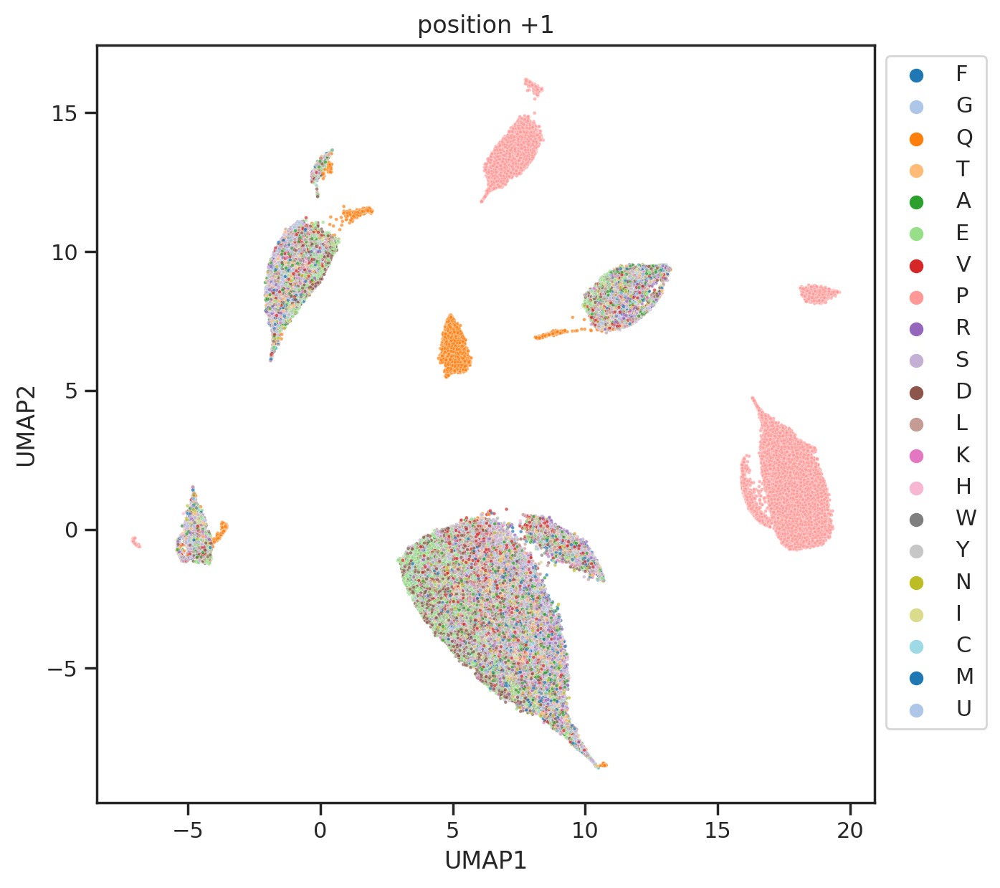

In [ ]:
plot_2d(results_umap,hue=unique_site.site_seq.str[8],palette='tab20')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.title('position +1');

In [ ]:
results['SRC'].values

array([0.79656308, 1.01167433, 1.02502515, ..., 0.50242201, 1.32541505, 0.46061047])

In [ ]:
query_list = ['ATM','ATR', # 1Q, DNA damage
             'CDK1','CDK2', # 1P, proliferation
              'CK1A','CK1G2','GRK5', # acidophilic
              'PKACA','AMPKA1','MAPKAPK3','PAK5','AURB','PKCA', # basophilic
              'WNK1','WNK2', #-2G
              'JAK2','ABL1', 'SRC', # TK
             ]

for i in query_list:
    plot_2d(results_umap,hue=results[i].values,palette='coolwarm')
    plt.title(i)
    plt.show()
    plt.close()

In [ ]:
results

kinase,SRC,EPHA3,FES,NTRK3,ALK,EPHA8,ABL1,FLT3,EPHB2,FYN,RET,PKACA,EPHB1,MUSK,INSR,EPHB3,FER,EPHB4,NTRK1,ROS1,TYRO3,SYK,TNK1,YES1,MET,BMX,FLT4,LTK,FRK,ERK2,LCK,FGFR1,MST1R,EPHA5,FGFR2,CDK1,TEK,IKKB,FGR,JAK3,LYN,SRMS,TEC,EPHA2,EPHA1,PDGFRA,INSRR,IGF1R,ERK1,BTK,AXL,PKCA,EPHA7,CDK2,ERBB4,MERTK,BLK,JAK2,PTK6,HCK,ABL2,JNK1,P38A,MLK1,PDGFRB,EPHA6,KDR,NEK6,PLK1,CK2A1,PTK2B,EGFR,DYRK2,P38D,HGK,TTBK1,MST3,NTRK2,MST1,IKKE,MST2,CSF1R,MINK,DDR2,NEK7,NEK2,TXK,ZAP70,CDK5,NEK1,MST4,QIK,P38G,KIT,CHK1,CAMK2A,KHS1,FGFR3,YSK1,CK1D,AKT1,RSK3,NEK4,GSK3B,TNIK,ITK,MAPKAPK3,TAO2,AURB,NIM1,FGFR4,MLK3,PAK3,FLT1,AURA,PIM1,EPHA4,AURC,MSK1,MARK4,CAMK2G,PLK3,ZAK,NEK9,P70S6K,PAK1,SGK3,MARK2,GCK,MLK2,PAK2,MEKK1,TBK1,CAMK2D,P90RSK,PHKG2,DYRK3,IKKA,P38B,TSSK1,ERK5,PIM3,TLK1,TAK1,JNK2,NLK,LIMK1,MAPKAPK5,SIK,DCAMKL2,MATK,AMPKA1,MAPKAPK2,CK2A2,CDK9,PKCB,JNK3,ALK4,IRAK1,RSK4,TNK2,IRAK4,DSTYK,CAMK2B,PKACB,PRKD3,PKCT,MARK1,MNK2,SGK1,DYRK4,MARK3,TAO1,TLK2,TSSK2,CK1E,PKG2,PRKD1,RSK2,AKT2,BUB1B,ULK3,DAPK1,GRK2,ROCK1,BMPR1B,PTK2,NEK11,LATS2,DYRK1A,CSK,CK1G2,CDK6,CK1A,PKCZ,GRK5,WNK3,ROCK2,ALK2,CAMKK1,ATM,PKG1,TGFBR1,AMPKA2,TYK2,PKN1,PKCG,MSK2,JAK1,NUAK2,GRK7,LKB1,WNK1,AKT3,PKCD,ICK,PBK,SKMLCK,LATS1,SGK2,WNK2,CAMK4,CK1G1,PRKD2,PLK4,PKCH,WEE1,CDK3,CHK2,CDK7,PKCE,CK1G3,PKCI,SLK,PRKX,DCAMKL1,EEF2K,MELK,CAMKK2,MEK2,HIPK2,CDK4,MTOR,PAK6,GSK3A,MOK,NDR1,NUAK1,PIM2,MEK1,TESK1,ERK7,NDR2,OSR1,CLK1,COT,ACVR2A,HIPK4,MEKK2,LRRK2,PHKG1,MAP2K4,PAK5,PERK,MOS,DNAPK,P70S6KB,CLK3,LIMK2,BRSK2,PAK4,STLK3,CAMK1A,CAMK1D,HASPIN,HIPK1,ASK1,ATR,MPSK1,MEK5,PKN2,MAP2K7,MRCKB,HIPK3,CDK8,BUB1,MEKK3,MAP2K3,GRK1
gene_site2,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ZBTB7A_S182,0.796563,0.779769,0.819841,0.963711,0.858688,0.754362,0.852700,0.840211,0.808867,0.766546,0.797308,1.768850,0.843462,0.879759,0.893456,0.811482,0.844492,0.815716,0.948659,0.883217,0.844688,0.813475,0.845922,0.767012,0.868566,0.805608,0.917525,0.809724,0.751722,1.697679,0.770129,0.856083,0.820181,0.775035,0.823884,1.558929,0.839418,1.712834,0.795359,0.916459,0.812857,0.805805,0.748316,0.790237,0.791171,0.893450,0.819866,0.912480,1.672840,0.813433,0.803114,1.670261,0.804066,1.621888,0.813100,0.838773,0.751520,0.873723,0.810792,0.813464,0.792473,1.596907,1.604978,1.541966,0.897439,0.811127,0.880569,1.551523,1.536153,1.610534,0.812010,0.786216,1.708458,1.557329,1.251667,1.544790,1.261957,0.822281,1.188482,1.706899,1.185148,0.770371,1.198892,0.753345,1.644103,1.567859,0.813209,0.786429,1.628837,1.290005,1.272203,1.751609,1.589232,0.785305,1.531981,1.625854,1.367075,0.833119,1.303420,1.656714,1.656993,1.681864,1.215529,1.854729,1.265482,0.842931,1.708211,1.395693,1.662163,1.782779,0.806515,1.533864,1.644513,0.841536,1.661102,1.498191,0.729775,1.559254,1.681286,1.682493,1.584014,1.490132,1.414198,1.655556,1.590762,1.646693,1.748441,1.748726,1.174817,1.479028,1.649889,1.341576,1.801925,1.573778,1.682235,1.822432,1.610495,1.731358,1.590541,1.812264,1.703905,1.526507,1.419416,1.067177,1.477187,1.493945,1.110575,1.701888,1.803249,1.537489,1.074437,1.688461,1.760588,1.608373,1.775426,1.747019,1.590898,1.467025,1.534882,1.609536,0.865440,1.395347,1.533312,1.657885,1.792198,1.779332,1.727536,1.764313,1.879894,1.530102,1.695232,1.790397,1.256849,1.385763,1.872214,1.731224,1.615945,1.803823,1.636168,1.667560,1.530259,1.979309,1.215971,1.436782,1.332652,1.388275,0.809304,1.328055,1.683769,1.666208,0.793479,1.651467,1.507196,1.651573,1.751062,1.469975,1.654792,1.327924,1.518045,1.290941,1.609669,1.736168,1.445218,1.824795,0.850188,1.775595,1.837006,1.746311,0.802827,1.907408,1.510369,1.190030,1.617984,1.659365,1.614829,1.481655,1.172357,1.584221,1.658460,1.595821,1.507848,1.789679,1.498264,1.744235,1.511905,1.673671,0.745687,1.598170,1.546534,1.705501,1.841034,1.459109,1.564304,1.459789,1.893978,1.755656,1.

In [ ]:
ref = CPTAC.get_luad_id(is_KB=True)

the dataset length is: 61705
after id mapping, the length is 236430
after removing duplicates of protein_site, the length is 235537


In [ ]:
df = pd.read_csv('TP53_metaP.csv').iloc[:,:2]

In [ ]:
df = df.merge(ref,'left')

In [ ]:
df = df.dropna(subset = 'site_seq')

In [ ]:
df.to_csv('TP53_metaP_mapped.csv',index=False)

In [ ]:
ref = CPTAC.get_luad_id()

the dataset length is: 61705
after id mapping, the length is 236430
after removing duplicates of gene_site, the length is 235537


In [ ]:
ref

,gene,site,site_seq,protein,gene_name,gene_site,protein_site
0,ENSG00000003056.8,S267,DDQLGEESEERDDHL,ENSP00000000412.3,M6PR,M6PR_S267,ENSP00000000412_S267
1,ENSG00000003056.8,S267,DDQLGEESEERDDHL,ENSP00000440488.2,M6PR,M6PR_S267,ENSP00000440488_S267
2,ENSG00000048028.11,S1053,PPTIRPNSPYDLCSR,ENSP00000003302.4,USP28,USP28_S1053,ENSP00000003302_S1053
3,ENSG00000048028.11,S1053,PPTIRPNSPYDLCSR,ENSP00000445743.1,USP28,USP28_S1053,ENSP00000445743_S1053
4,ENSG00000048028.11,S1053,PPTIRPNSPYDLCSR,ENSP00000442431.1,USP28,USP28_S1053,ENSP00000442431_S1053
...,...,...,...,...,...,...,...
235532,ENSG00000187608.10,S94,RNNKGRSSTYEVRLT,ENSP00000496832.1,ISG15,ISG15_S94,ENSP00000496832_S94
235533,ENSG00000242802.9,T263,EGPGTLDTDDRSEQE,ENSP00000497815.1,AP5Z1,AP5Z1_T263,ENSP00000497815_T263
235534,ENSG00000178971.16,S753,FCVPPGASPEVPKPA,ENSP00000498499.1,CTC1,CTC1_S753,ENSP00000498499_S753
235535,ENSG00000085377.14,S667,VGRSRKQSNPLLIHV,ENSP00000358106.4,PREP,PREP_S667,ENSP00000358106_S667


In [ ]:
ref.protein.str.split('.')

0        [ENSP00000000412, 3]
1        [ENSP00000003302, 4]
2        [ENSP00000003302, 4]
3        [ENSP00000003302, 4]
4        [ENSP00000003302, 4]
                 ...         
61589    [ENSP00000493901, 2]
61590    [ENSP00000485643, 1]
61591    [ENSP00000497815, 1]
61592    [ENSP00000498499, 1]
61593    [ENSP00000358106, 4]
Name: protein, Length: 61594, dtype: object

In [ ]:
ref = CPTAC.get_luad_id()[['gene_site','site_seq']]

the dataset length is: 61705
after id mapping, the length is 61705
after removing duplicates of gene_site, the length is 61594


In [ ]:
df = pd.read_csv('Link_LUAD_EGFR.csv')

In [ ]:
df

,gene_site,log2FC_mean,P-value,FDR,Event_SD,Event_TD
0,M6PR_S267,-0.225754,0.006417,0.096139,39,108
1,USP28_S1053,0.162096,0.110735,0.390904,39,108
2,HSPB6_S16,-0.292419,0.023743,0.186494,39,108
3,RALA_S11,-0.099056,0.368461,0.666695,39,108
4,BAIAP2L1_S331,0.015393,0.922128,0.970173,39,108
...,...,...,...,...,...,...
33013,EPB41L1_T29,0.097951,0.582244,0.810149,39,19
33014,TNS1_S1583,0.206155,0.565171,0.800378,39,20
33015,PATJ_S836,0.512303,0.046114,0.257938,39,20
33016,FRY_T2508,0.314795,0.321761,0.629458,39,20


In [ ]:
df2 = df.merge(ref)

In [ ]:
df2.to_csv('Link_LUAD_EGFR_mapped.csv',index=False)